In [1]:
import pandas as pd
import os
import numpy as np
from PIL import Image
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
import torch
import torch.nn as nn
import tqdm
import matplotlib.pyplot as plt 
import seaborn as sns
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import matplotlib.ticker as ticker
import datetime as dt

/shared/centos7/anaconda3/2021.05/lib/python3.8/site-packages/scipy/__init__.py:138: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3)
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion} is required for this version of "


In [2]:
cleaned_merged_df = pd.read_pickle('Cleaned_input_data_pickle.pkl')

In [3]:
dataset = cleaned_merged_df.loc[cleaned_merged_df['popularity'] > cleaned_merged_df['popularity'].quantile(0.70)]



In [4]:

# Combine necessary columns to form a new 'combined_desc' column
dataset['combined_desc'] = dataset['product_group_name'] + " " + \
                       dataset['product_type_name'] + " " + \
                       dataset['colour_group_name'] + " " + \
                       dataset['garment_group_name'] + " " + \
                       dataset['detail_desc']


# Show the new combined column
print(dataset[['combined_desc']].head())

                                       combined_desc
0  Garment Upper body Vest top Black Jersey Basic...
1  Garment Upper body Vest top White Jersey Basic...
2  Garment Upper body Vest top Off White Jersey B...
3  Underwear Bra Black Under-, Nightwear Microfib...
4  Underwear Bra White Under-, Nightwear Microfib...


<ipython-input-4-0852273a382e>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['combined_desc'] = dataset['product_group_name'] + " " + \


In [5]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import re

# Download necessary NLTK resources
nltk.download('punkt')
nltk.download('stopwords')

# Function to clean and tokenize the text
def clean_and_tokenize(text):
    # Remove non-alphanumeric characters (including punctuation)
    text = re.sub(r'[^a-zA-Z\s]', '', text.lower())
    
    # Tokenize the text into words
    words = word_tokenize(text)
    
    # Remove stop words
    stop_words = set(stopwords.words('english'))
    words = [word for word in words if word not in stop_words]
    
    # Remove repeating words (unique words only)
    words = list(set(words))
    
    return " ".join(words)



[nltk_data] Downloading package punkt to /home/khan.rida/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /home/khan.rida/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [6]:

# Apply cleaning and tokenization to the 'combined_desc' column
dataset['cleaned_combined_desc'] = dataset['combined_desc'].apply(clean_and_tokenize)



<ipython-input-6-1a61517b3048>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['cleaned_combined_desc'] = dataset['combined_desc'].apply(clean_and_tokenize)


In [7]:
print(dataset[['cleaned_combined_desc']].head())

                               cleaned_combined_desc
0  shoulder black vest garment jersey basic top u...
1  shoulder vest garment jersey basic top upper n...
2  shoulder vest garment jersey basic top upper n...
3  support greater provide hookandeye bust cups s...
4  support greater provide hookandeye bust cups s...


In [8]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Vectorize the cleaned combined descriptions using TF-IDF
tfidf_vectorizer = TfidfVectorizer(max_features=500)  # Limit to top 500 words for simplicity
tfidf_matrix = tfidf_vectorizer.fit_transform(dataset['cleaned_combined_desc'])

# tfidf_matrix is a sparse matrix of shape (num_samples, 500)


In [9]:
from transformers import BertTokenizer, BertModel
import torch

# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load pre-trained BERT model and tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertModel.from_pretrained('bert-base-uncased').to(device)  # Move the model to GPU

# Function to generate embeddings using BERT
def get_bert_embeddings(texts, batch_size=32):
    embeddings_list = []
    
    # Process the texts in batches to avoid memory overflow and speed up
    for i in range(0, len(texts), batch_size):
        batch = texts[i:i+batch_size]
        #print(i,len(texts) )
        # Tokenize the batch of texts and move to GPU
        inputs = tokenizer(batch, return_tensors='pt', padding=True, truncation=True, max_length=512)
        inputs = {key: value.to(device) for key, value in inputs.items()}
        
        # Get BERT embeddings (with no gradient computation)
        with torch.no_grad():
            outputs = model(**inputs)
        
        # Use the mean of token embeddings for each sentence
        embeddings_batch = outputs.last_hidden_state.mean(dim=1)
        
        # Append batch embeddings to the list
        embeddings_list.append(embeddings_batch.cpu())  # Move embeddings back to CPU
        
    # Concatenate the list of embeddings
    all_embeddings = torch.cat(embeddings_list, dim=0)
    
    return all_embeddings





In [10]:
# Get BERT embeddings for the cleaned combined descriptions (with batching)
embeddings = get_bert_embeddings(dataset['cleaned_combined_desc'].tolist(), batch_size=32)

# embeddings will be a tensor of shape [num_samples, embedding_dim]
print(embeddings.shape)  # Check the shape of the embeddings tensor

torch.Size([30758, 768])


In [11]:
import faiss
import numpy as np

# Convert embeddings to numpy arrays
embeddings_np = embeddings.cpu().numpy()
embeddings_np = embeddings_np.astype('float32')





In [12]:
# Build the Faiss index (use L2 distance or cosine similarity)
index = faiss.IndexFlatL2(embeddings_np.shape[1])  # L2 distance
index.add(embeddings_np)  # Add embeddings to the index


In [13]:

K = 5  # Top K neighbors
distances, indices = index.search(embeddings_np, K)  # Perform the search

In [14]:
import random

positive_pairs = set()  # Use a set to avoid duplicates
negative_pairs = []

for i in range(len(embeddings_np)):
    # Get top K nearest neighbors (positive pairs)
    neighbors = indices[i]  # Top K neighbors for the i-th item
    #print(f"Top 5 neighbors for item {i}:")
    
    # Initialize an empty list for positive pairs for this item
    item_positive_pairs = []

    for j, neighbor in enumerate(neighbors):
        # Skip the self-match (i, i) pair
        if i != neighbor:
            item_positive_pairs.append(neighbor)
            positive_pairs.add((i, neighbor))
            #print(f"    Neighbor {j+1}: Item {neighbor} (Distance: {distances[i][j]:.4f})")
    
    # Now match the number of negative samples to the positive pairs
    K = len(item_positive_pairs)  # Number of valid positive pairs
    all_items = set(range(len(embeddings_np)))
    negative_items = list(all_items - set(item_positive_pairs) - {i})  # Exclude the positive items and self
    
    # Ensure we sample exactly K negative items to match positive pairs count
    sampled_negatives = random.sample(negative_items, K)  # Sample K negative items
    
    for negative_item in sampled_negatives:
        negative_pairs.append((i, negative_item))

    #print("\n")

# Convert the positive_pairs set back to a list
positive_pairs = list(positive_pairs)

# Now positive_pairs and negative_pairs can be used for training
training_pairs = positive_pairs + negative_pairs


In [15]:
len(training_pairs)

246226

In [16]:

# Shuffle the list in place
random.shuffle(training_pairs)

# Print the shuffled list
print("Shuffled list:", len(training_pairs))


Shuffled list: 246226


In [17]:
train_length = int(len(training_pairs) *0.8)

train_pairs = training_pairs[:train_length]
test_pairs = training_pairs[train_length:]

In [18]:
len(train_pairs), len(test_pairs)

(196980, 49246)

In [ ]:
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import torch

# Assuming you already have a list of positive pairs (i, j) and the embeddings are computed
# Also assuming your df has 'image_path' and other relevant columns like 'prod_name'

# Sample: Choose an item index and retrieve its positive pairs
item_index = 66 # You can choose any item index here
similar_items = indices[item_index][:5]  # Get top 5 similar items (indices)

# Prepare to display the original item and its similar items
fig, axes = plt.subplots(1, len(similar_items) + 1, figsize=(15, 5))

# Show the original item
original_item = dataset.iloc[item_index]
print(f"../{original_item['image_path']}")
img = mpimg.imread(f"../{original_item['image_path']}")
axes[0].imshow(img)
axes[0].axis('off')
axes[0].set_title(f"Original: {original_item['prod_name']}")

# Show the similar items
for idx, similar_index in enumerate(similar_items):
    similar_item = dataset.iloc[similar_index]
    print(f"../{similar_item['image_path']}")
    img = mpimg.imread(f"../{similar_item['image_path']}")
    
    axes[idx + 1].imshow(img)
    axes[idx + 1].axis('off')
    axes[idx + 1].set_title(f"Similar: {similar_item['prod_name']}")

plt.tight_layout()
plt.show()


In [19]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
import random

# Custom Dataset for Contrastive Learning
class ContrastiveDataset(Dataset):
    def __init__(self, df, pairs):
        """
        Args:
            df (pd.DataFrame): DataFrame containing the product data with ResNet embeddings in the 'features' column.
            pairs (list of tuples): List of pairs of indices for positive and negative samples
        """
        self.df = df
        self.pairs = pairs
        #print(df.info())
        

    
    def __len__(self):
        return len(self.pairs)
    
    def __getitem__(self, idx):
        # Get the indices for the pair
        idx1, idx2 = self.pairs[idx]
        
        # Fetch embeddings (features) for each product pair
        embedding1 = torch.tensor(self.df.iloc[idx1]['features'], dtype=torch.float32)  # ResNet embedding for product 1
        embedding2 = torch.tensor(self.df.iloc[idx2]['features'], dtype=torch.float32)  # ResNet embedding for product 2
        #print(embedding1)
        return embedding1, embedding2

In [20]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim import AdamW
from torch.optim.lr_scheduler import CosineAnnealingLR

class FeatureExtractor(nn.Module):
    def __init__(self, input_dim, hidden_dims=[1024], output_dim=512):
        super(FeatureExtractor, self).__init__()

        layers = []
        prev_dim = input_dim
        for hidden_dim in hidden_dims:
            layers.append(nn.Linear(prev_dim, hidden_dim))
            layers.append(nn.ReLU())  # Activation function after the linear layer
            layers.append(nn.Dropout(p=0.2))  # Regularization with dropout
            # Optionally add Batch Normalization to stabilize training
            layers.append(nn.BatchNorm1d(hidden_dim))  # Optional

            prev_dim = hidden_dim

        # Final output layer
        layers.append(nn.Linear(prev_dim, output_dim))
        self.network = nn.Sequential(*layers)

        # Initialize weights (optional but recommended)
        self._initialize_weights()

    def _initialize_weights(self):
        # Use Xavier initialization for better weight distribution
        for m in self.network:
            if isinstance(m, nn.Linear):
                nn.init.xavier_normal_(m.weight)
                if m.bias is not None:
                    nn.init.zeros_(m.bias)

    def forward(self, x):
        return self.network(x)

class ProjectionHead(nn.Module):
    def __init__(self, input_dim, projection_dim=128):
        super(ProjectionHead, self).__init__()

        # A single fully connected layer followed by dropout and ReLU
        self.fc1 = nn.Linear(input_dim, projection_dim)  # First projection layer
        self.network = nn.Sequential(
            nn.ReLU(),
            nn.Dropout(p=0.2),  # Regularization using dropout
            self.fc1
        )

    def forward(self, x):
        return self.network(x)

class SimCLR(nn.Module):
    def __init__(self, input_dim, feature_extractor, projection_head):
        super(SimCLR, self).__init__()
        # The feature extractor (e.g., MLP or CNN)
        self.feature_extractor = feature_extractor
        # The projection head (e.g., additional MLP to project into a contrastive space)
        self.projection_head = projection_head

    def forward(self, x):
        # Extract features from the input data
        features = self.feature_extractor(x)  # Shape: (batch_size, feature_dim)
        
        # Project the features into a space suitable for contrastive loss
        projections = self.projection_head(features)  # Shape: (batch_size, projection_dim)
        
        return projections


class NTXentLoss(nn.Module):
    def __init__(self, temperature=0.1):
        super(NTXentLoss, self).__init__()
        self.temperature = temperature

    def forward(self, z1, z2):
        # Normalize embeddings to unit length
        z1 = F.normalize(z1, dim=-1, p=2)
        z2 = F.normalize(z2, dim=-1, p=2)
        
        # Compute cosine similarity matrix between all pairs in z1 and z2
        similarity_matrix = torch.matmul(z1, z2.T)  # Shape: [batch_size, batch_size]
        
        # Scale similarity by temperature
        similarity_matrix /= self.temperature
        
        # Create labels: for each pair, the correct label is the same index in z1 and z2
        labels = torch.arange(z1.size(0), device=z1.device)  # Shape: [batch_size]

        # Apply cross-entropy loss (softmax on each row, compare to diagonal labels)
        loss = F.cross_entropy(similarity_matrix, labels)
        
        return loss


In [21]:
dataset.head()

,article_id,product_code,product_group_name,product_type_name,image_name,image_path,features,prod_name,graphical_appearance_name,colour_group_code,...,perceived_colour_master_name,department_name,index_name,index_group_name,section_name,garment_group_name,detail_desc,popularity,combined_desc,cleaned_combined_desc
0,108775015,108775,Garment Upper body,Vest top,0108775015,Dataset/images/010/0108775015.jpg,"[0.3000537, 1.8002657, 0.0, 0.16126277, 0.1846...",Strap top,Solid,9,...,Black,Jersey Basic,Ladieswear,Ladieswear,Womens Everyday Basics,Jersey Basic,Jersey top with narrow shoulder straps.,10841.0,Garment Upper body Vest top Black Jersey Basic...,shoulder black vest garment jersey basic top u...
1,108775044,108775,Garment Upper body,Vest top,0108775044,Dataset/images/010/0108775044.jpg,"[0.0, 2.1636648, 0.03160977, 1.3541692, 0.0421...",Strap top,Solid,10,...,White,Jersey Basic,Ladieswear,Ladieswear,Womens Everyday Basics,Jersey Basic,Jersey top with narrow shoulder straps.,7250.0,Garment Upper body Vest top White Jersey Basic...,shoulder vest garment jersey basic top upper n...
2,108775051,108775,Garment Upper body,Vest top,0108775051,Dataset/images/010/0108775051.jpg,"[0.6450884, 0.6914512, 0.050121397, 0.3615836,...",Strap top (1),Stripe,11,...,White,Jersey Basic,Ladieswear,Ladieswear,Womens Everyday Basics,Jersey Basic,Jersey top with narrow shoulder straps.,215.0,Garment Upper body Vest top Off White Jersey B...,shoulder vest garment jersey basic top upper n...
3,110065001,110065,Underwear,Bra,0110065001,Dataset/images/011/0110065001.jpg,"[0.028639015, 2.0282106, 0.08630324, 0.2328320...",OP T-shirt (Idro),Solid,9,...,Black,Clean Lingerie,Lingeries/Tights,Ladieswear,Womens Lingerie,"Under-, Nightwear","Microfibre T-shirt bra with underwired, moulde...",1044.0,"Underwear Bra Black Under-, Nightwear Microfib...",support greater provide hookandeye bust cups s...
4,110065002,110065,Underwear,Bra,0110065002,Dataset/images/011/0110065002.jpg,"[0.038957007, 1.2950683, 0.0, 0.018434042, 0.0...",OP T-shirt (Idro),Solid,10,...,White,Clean Lingerie,Lingeries/Tights,Ladieswear,Womens Lingerie,"Under-, Nightwear","Microfibre T-shirt bra with underwired, moulde...",539.0,"Underwear Bra White Under-, Nightwear Microfib...",support greater provide hookandeye bust cups s...


In [22]:
from tqdm import tqdm
# Create Dataset and DataLoader
con_dataset = ContrastiveDataset(dataset, train_pairs)
train_loader = DataLoader(con_dataset, batch_size=256, shuffle=True)


In [24]:

# Check if GPU is available and set device accordingly
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Initialize model components
input_dim = 2048        # Feature size of input data
hidden_dims = [512, 256]  # Gradual reduction in dimensions
output_dim = 128       # Final feature embedding size
projection_dim = 64    # Size of the projection for contrastive loss


# Create model
feature_extractor = FeatureExtractor(input_dim=input_dim, hidden_dims=hidden_dims, output_dim=output_dim)
projection_head = ProjectionHead(input_dim=output_dim, projection_dim=projection_dim)
model = SimCLR(input_dim=input_dim, feature_extractor=feature_extractor, projection_head=projection_head)

# Move model to the selected device
model.to(device)

# Loss function and optimizer
contrastive_loss = NTXentLoss(temperature=0.1)  # Adjust temperature as needed
#optimizer = optim.SGD(model.parameters(), lr=1e-2, momentum=0.9, weight_decay=1e-4)
optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9, weight_decay=1e-3)
scheduler = CosineAnnealingLR(optimizer, T_max=2)

# Set the model to training mode
model.train()

# Training loop with tqdm for progress bar
epochs = 50 # Define the number of epochs you want to train for

for epoch in range(epochs):
    epoch_loss = 0.0
    with tqdm(train_loader, desc=f"Epoch {epoch + 1}/{epochs}", unit="batch") as pbar:
        for x1, x2 in pbar:  # Unpack item1, item2, and label
            
            optimizer.zero_grad()
            
            # Move data to GPU if available
            x1, x2 = x1.to(device), x2.to(device)

            # Forward pass for SimCLR
            z1 = model(x1)  # Feature projections for batch 1
            z2 = model(x2)  # Feature projections for batch 2
            
            import torch.nn.functional as F

            
            # Compute the contrastive loss
            loss = contrastive_loss(z1, z2)
            epoch_loss += loss.item()

            # Backward pass and optimization
            loss.backward()
            optimizer.step()

            # Update the progress bar with the current loss
            pbar.set_postfix({"Loss": loss.item()})

    print(f"Epoch {epoch + 1} - Average Loss: {epoch_loss / len(train_loader)}")
    # Compute similarity
    positive_similarity = F.cosine_similarity(z1, z2).mean().item()
    negative_similarity = F.cosine_similarity(z1, z2[torch.randperm(z2.size(0))]).mean().item()

    print(f"Positive Similarity: {positive_similarity:.4f}")
    print(f"Negative Similarity: {negative_similarity:.4f}")

            

Epoch 2/50:   0%|          | 2/770 [00:00<00:51, 14.91batch/s, Loss=5.24]

Epoch 1 - Average Loss: 5.295082195703086
Positive Similarity: 0.7506
Negative Similarity: 0.6664


Epoch 3/50:   0%|          | 2/770 [00:00<00:49, 15.37batch/s, Loss=5.12]

Epoch 2 - Average Loss: 5.1041851136591525
Positive Similarity: 0.7347
Negative Similarity: 0.6477


Epoch 4/50:   0%|          | 2/770 [00:00<00:49, 15.65batch/s, Loss=4.96]

Epoch 3 - Average Loss: 5.029762451370041
Positive Similarity: 0.7250
Negative Similarity: 0.6267


Epoch 5/50:   0%|          | 2/770 [00:00<00:48, 15.76batch/s, Loss=4.85]

Epoch 4 - Average Loss: 4.980450349659114
Positive Similarity: 0.7207
Negative Similarity: 0.6015


Epoch 6/50:   0%|          | 2/770 [00:00<00:50, 15.35batch/s, Loss=4.87]

Epoch 5 - Average Loss: 4.940463059908383
Positive Similarity: 0.7070
Negative Similarity: 0.5910


Epoch 7/50:   0%|          | 2/770 [00:00<00:50, 15.30batch/s, Loss=4.97]

Epoch 6 - Average Loss: 4.905980939988966
Positive Similarity: 0.7182
Negative Similarity: 0.5964


Epoch 8/50:   0%|          | 2/770 [00:00<00:50, 15.22batch/s, Loss=4.94]

Epoch 7 - Average Loss: 4.878666206458946
Positive Similarity: 0.7081
Negative Similarity: 0.5843


Epoch 9/50:   0%|          | 2/770 [00:00<00:53, 14.47batch/s, Loss=4.91]

Epoch 8 - Average Loss: 4.851119484839502
Positive Similarity: 0.6751
Negative Similarity: 0.5777


Epoch 10/50:   0%|          | 2/770 [00:00<00:48, 15.72batch/s, Loss=4.96]

Epoch 9 - Average Loss: 4.829455436050118
Positive Similarity: 0.7074
Negative Similarity: 0.5822


Epoch 11/50:   0%|          | 2/770 [00:00<00:49, 15.61batch/s, Loss=4.94]

Epoch 10 - Average Loss: 4.8105734422609405
Positive Similarity: 0.6714
Negative Similarity: 0.5666


Epoch 12/50:   0%|          | 2/770 [00:00<00:49, 15.37batch/s, Loss=4.74]

Epoch 11 - Average Loss: 4.792297340987565
Positive Similarity: 0.6612
Negative Similarity: 0.5443


Epoch 13/50:   0%|          | 2/770 [00:00<00:49, 15.59batch/s, Loss=4.81]

Epoch 12 - Average Loss: 4.773176750889072
Positive Similarity: 0.6993
Negative Similarity: 0.5421


Epoch 14/50:   0%|          | 2/770 [00:00<00:49, 15.64batch/s, Loss=4.77]

Epoch 13 - Average Loss: 4.755446778334581
Positive Similarity: 0.6919
Negative Similarity: 0.5463


Epoch 15/50:   0%|          | 2/770 [00:00<00:49, 15.55batch/s, Loss=4.75]

Epoch 14 - Average Loss: 4.741629173538902
Positive Similarity: 0.6879
Negative Similarity: 0.5532


Epoch 16/50:   0%|          | 2/770 [00:00<00:50, 15.33batch/s, Loss=4.61]

Epoch 15 - Average Loss: 4.725247259883138
Positive Similarity: 0.6683
Negative Similarity: 0.5383


Epoch 17/50:   0%|          | 2/770 [00:00<00:49, 15.54batch/s, Loss=4.73]

Epoch 16 - Average Loss: 4.712269865692436
Positive Similarity: 0.6990
Negative Similarity: 0.5125


Epoch 18/50:   0%|          | 2/770 [00:00<00:50, 15.27batch/s, Loss=4.88]

Epoch 17 - Average Loss: 4.696953238450088
Positive Similarity: 0.6916
Negative Similarity: 0.5182


Epoch 19/50:   0%|          | 2/770 [00:00<00:49, 15.55batch/s, Loss=4.6] 

Epoch 18 - Average Loss: 4.686524335130469
Positive Similarity: 0.6662
Negative Similarity: 0.5234


Epoch 20/50:   0%|          | 2/770 [00:00<00:49, 15.38batch/s, Loss=4.52]

Epoch 19 - Average Loss: 4.672676453033051
Positive Similarity: 0.6404
Negative Similarity: 0.5193


Epoch 21/50:   0%|          | 2/770 [00:00<00:48, 15.84batch/s, Loss=4.46]

Epoch 20 - Average Loss: 4.66117532160375
Positive Similarity: 0.6431
Negative Similarity: 0.4978


Epoch 22/50:   0%|          | 2/770 [00:00<00:48, 15.68batch/s, Loss=4.64]

Epoch 21 - Average Loss: 4.65126024902641
Positive Similarity: 0.6325
Negative Similarity: 0.5190


Epoch 23/50:   0%|          | 2/770 [00:00<00:49, 15.46batch/s, Loss=4.72]

Epoch 22 - Average Loss: 4.638876557659793
Positive Similarity: 0.6519
Negative Similarity: 0.4900


Epoch 24/50:   0%|          | 2/770 [00:00<00:48, 15.68batch/s, Loss=4.57]

Epoch 23 - Average Loss: 4.629867279374754
Positive Similarity: 0.6425
Negative Similarity: 0.5074


Epoch 25/50:   0%|          | 2/770 [00:00<00:48, 15.87batch/s, Loss=4.4]

Epoch 24 - Average Loss: 4.6163095381352806
Positive Similarity: 0.6433
Negative Similarity: 0.4949


Epoch 26/50:   0%|          | 2/770 [00:00<00:48, 15.79batch/s, Loss=4.69]

Epoch 25 - Average Loss: 4.605788415128535
Positive Similarity: 0.6619
Negative Similarity: 0.5063


Epoch 27/50:   0%|          | 2/770 [00:00<00:51, 14.98batch/s, Loss=4.62]

Epoch 26 - Average Loss: 4.5977101146400745
Positive Similarity: 0.6431
Negative Similarity: 0.5000


Epoch 28/50:   0%|          | 2/770 [00:00<00:49, 15.39batch/s, Loss=4.44]

Epoch 27 - Average Loss: 4.587657078829679
Positive Similarity: 0.6681
Negative Similarity: 0.4815


Epoch 29/50:   0%|          | 2/770 [00:00<00:53, 14.28batch/s, Loss=4.63]

Epoch 28 - Average Loss: 4.574759675310804
Positive Similarity: 0.6260
Negative Similarity: 0.4765


Epoch 30/50:   0%|          | 2/770 [00:00<00:49, 15.46batch/s, Loss=4.57]

Epoch 29 - Average Loss: 4.56580732147415
Positive Similarity: 0.6491
Negative Similarity: 0.4719


Epoch 31/50:   0%|          | 2/770 [00:00<00:50, 15.24batch/s, Loss=4.5] 

Epoch 30 - Average Loss: 4.556913919572707
Positive Similarity: 0.6146
Negative Similarity: 0.4776


Epoch 32/50:   0%|          | 2/770 [00:00<00:53, 14.47batch/s, Loss=4.53]

Epoch 31 - Average Loss: 4.547240725430576
Positive Similarity: 0.6125
Negative Similarity: 0.4708


Epoch 33/50:   0%|          | 2/770 [00:00<00:49, 15.37batch/s, Loss=4.67]

Epoch 32 - Average Loss: 4.540333449995363
Positive Similarity: 0.6175
Negative Similarity: 0.4733


Epoch 34/50:   0%|          | 2/770 [00:00<00:50, 15.24batch/s, Loss=4.44]

Epoch 33 - Average Loss: 4.534556271503498
Positive Similarity: 0.6216
Negative Similarity: 0.4543


Epoch 35/50:   0%|          | 2/770 [00:00<00:49, 15.59batch/s, Loss=4.48]

Epoch 34 - Average Loss: 4.525661014581655
Positive Similarity: 0.6263
Negative Similarity: 0.4680


Epoch 36/50:   0%|          | 2/770 [00:00<00:51, 14.92batch/s, Loss=4.62]

Epoch 35 - Average Loss: 4.519161730927307
Positive Similarity: 0.5966
Negative Similarity: 0.4493


Epoch 37/50:   0%|          | 2/770 [00:00<00:49, 15.47batch/s, Loss=4.59]

Epoch 36 - Average Loss: 4.50996082850865
Positive Similarity: 0.6120
Negative Similarity: 0.4508


Epoch 38/50:   0%|          | 2/770 [00:00<00:49, 15.54batch/s, Loss=4.33]

Epoch 37 - Average Loss: 4.5023366184977744
Positive Similarity: 0.6448
Negative Similarity: 0.4366


Epoch 39/50:   0%|          | 2/770 [00:00<00:49, 15.49batch/s, Loss=4.46]

Epoch 38 - Average Loss: 4.494100090745207
Positive Similarity: 0.6203
Negative Similarity: 0.4545


Epoch 40/50:   0%|          | 2/770 [00:00<00:49, 15.45batch/s, Loss=4.74]

Epoch 39 - Average Loss: 4.488378599092558
Positive Similarity: 0.5849
Negative Similarity: 0.4574


Epoch 41/50:   0%|          | 2/770 [00:00<00:51, 14.87batch/s, Loss=4.46]

Epoch 40 - Average Loss: 4.484264258904891
Positive Similarity: 0.6285
Negative Similarity: 0.4314


Epoch 42/50:   0%|          | 2/770 [00:00<00:51, 14.97batch/s, Loss=4.49]

Epoch 41 - Average Loss: 4.475476843660528
Positive Similarity: 0.6238
Negative Similarity: 0.4287


Epoch 43/50:   0%|          | 2/770 [00:00<00:49, 15.57batch/s, Loss=4.42]

Epoch 42 - Average Loss: 4.468094666282852
Positive Similarity: 0.6179
Negative Similarity: 0.4223


Epoch 44/50:   0%|          | 2/770 [00:00<00:49, 15.48batch/s, Loss=4.49]

Epoch 43 - Average Loss: 4.461501439515646
Positive Similarity: 0.6060
Negative Similarity: 0.4286


Epoch 45/50:   0%|          | 2/770 [00:00<00:52, 14.73batch/s, Loss=4.35]

Epoch 44 - Average Loss: 4.456239765959901
Positive Similarity: 0.6115
Negative Similarity: 0.4330


Epoch 46/50:   0%|          | 2/770 [00:00<00:50, 15.31batch/s, Loss=4.53]

Epoch 45 - Average Loss: 4.451458081022485
Positive Similarity: 0.5793
Negative Similarity: 0.4381


Epoch 47/50:   0%|          | 2/770 [00:00<00:48, 15.81batch/s, Loss=4.31]

Epoch 46 - Average Loss: 4.443369493546424
Positive Similarity: 0.5997
Negative Similarity: 0.4325


Epoch 48/50:   0%|          | 2/770 [00:00<00:49, 15.52batch/s, Loss=4.51]

Epoch 47 - Average Loss: 4.440038179731988
Positive Similarity: 0.5879
Negative Similarity: 0.4239


Epoch 49/50:   0%|          | 2/770 [00:00<00:50, 15.26batch/s, Loss=4.64]

Epoch 48 - Average Loss: 4.433330744891972
Positive Similarity: 0.6111
Negative Similarity: 0.4036


Epoch 50/50:   0%|          | 2/770 [00:00<00:48, 15.78batch/s, Loss=4.72]

Epoch 49 - Average Loss: 4.430373167991638
Positive Similarity: 0.6217
Negative Similarity: 0.4238


Epoch 50/50: 100%|██████████| 770/770 [00:47<00:00, 16.24batch/s, Loss=3.74]

Epoch 50 - Average Loss: 4.427503038071967
Positive Similarity: 0.5978
Negative Similarity: 0.4237


In [26]:
torch.save(model.state_dict(), 'contrastive_model_50_epochs_V0.2.pth')


In [28]:

# Initialize empty lists for positive and negative test pairs
positive_test_pairs = []
negative_test_pairs = []

# Loop through test pairs and classify them
for pair in test_pairs:
    if pair in positive_pairs:
        positive_test_pairs.append(pair)
    elif pair in negative_pairs:
        negative_test_pairs.append(pair)

# Output
print(f"Positive Test Pairs: {len(positive_test_pairs)}")
print(f"Negative Test Pairs: {len(negative_test_pairs)}")


Positive Test Pairs: 24524
Negative Test Pairs: 24722


In [39]:
import torch
import torch.nn.functional as F
import numpy as np

# Example DataFrame
# Assuming df['features'] contains the embeddings as lists or arrays
df = dataset.copy()

# Convert feature column to torch tensors if not already
df['features'] = df['features'].apply(lambda x: torch.tensor(np.array(x), dtype=torch.float32))

# Initialize list to store cosine distances
positive_cosine_distances = []

# Convert device if necessary (e.g., for GPU processing)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
df['features'] = df['features'].apply(lambda x: x.to(device))

# Collect embeddings for all pairs in a batch
batch_emb_a = []
batch_emb_b = []

for i, j in positive_test_pairs:
    batch_emb_a.append(df.iloc[i]['features'])
    batch_emb_b.append(df.iloc[j]['features'])

# Stack all pairs together to form a batch
batch_emb_a = torch.stack(batch_emb_a)  # Shape: (batch_size, input_dim)
batch_emb_b = torch.stack(batch_emb_b)  # Shape: (batch_size, input_dim)

# Forward pass through the model to get the projections
proj_a = model(batch_emb_a)  # Shape: (batch_size, projection_dim)
proj_b = model(batch_emb_b)  # Shape: (batch_size, projection_dim)

# Calculate cosine similarity between all projections
cosine_sim = F.cosine_similarity(proj_a, proj_b)

# Convert similarity to distance
positive_cosine_distances = (1 - cosine_sim).tolist()

# Print individual cosine distances for each pair
#for idx, distance in enumerate(cosine_distances):
#    print(f"Cosine Distance for pair {idx + 1}: {distance:.4f}")

# Calculate the average cosine distance across all positive pairs
positive_average_cosine_distance = sum(positive_cosine_distances) / len(positive_cosine_distances)
print(f"\nAverage Cosine Distance for all positive pairs: {positive_average_cosine_distance:.4f}")



Average Cosine Distance for all positive pairs: 0.2286


In [38]:
import torch
import torch.nn.functional as F
import numpy as np

# Example DataFrame
# Assuming df['features'] contains the embeddings as lists or arrays
df = dataset.copy()

# Convert feature column to torch tensors if not already
df['features'] = df['features'].apply(lambda x: torch.tensor(np.array(x), dtype=torch.float32))

# Initialize list to store cosine distances
negative_cosine_distances = []

# Convert device if necessary (e.g., for GPU processing)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
df['features'] = df['features'].apply(lambda x: x.to(device))

# Collect embeddings for all pairs in a batch
batch_emb_a = []
batch_emb_b = []

for i, j in negative_test_pairs:
    batch_emb_a.append(df.iloc[i]['features'])
    batch_emb_b.append(df.iloc[j]['features'])

# Stack all pairs together to form a batch
batch_emb_a = torch.stack(batch_emb_a)  # Shape: (batch_size, input_dim)
batch_emb_b = torch.stack(batch_emb_b)  # Shape: (batch_size, input_dim)

# Forward pass through the model to get the projections
proj_a = model(batch_emb_a)  # Shape: (batch_size, projection_dim)
proj_b = model(batch_emb_b)  # Shape: (batch_size, projection_dim)

# Calculate cosine similarity between all projections
cosine_sim = F.cosine_similarity(proj_a, proj_b)

# Convert similarity to distance
negative_cosine_distances = (1 - cosine_sim).tolist()

# Print individual cosine distances for each pair
#for idx, distance in enumerate(cosine_distances):
#    print(f"Cosine Distance for pair {idx + 1}: {distance:.4f}")

# Calculate the average cosine distance across all positive pairs
negative_average_cosine_distance = sum(negative_cosine_distances) / len(negative_cosine_distances)
print(f"\nAverage Cosine Distance for all negative pairs: {negative_average_cosine_distance:.4f}")



Average Cosine Distance for all negative pairs: 0.5849


In [41]:
dataset.to_pickle('dataset_v_final.pkl')

In [43]:
import pickle
with open('negative_cosine_distances_v_final.pkl','wb') as f:
    pickle.dump(negative_cosine_distances, f)


In [44]:
with open('positive_cosine_distances_v_final.pkl','wb') as f:
    pickle.dump(positive_cosine_distances, f)


In [48]:
np.mean(positive_cosine_distances)

0.22858105450163774

In [49]:
np.std(positive_cosine_distances)

0.11865268044034316

In [50]:
np.mean(negative_cosine_distances)

0.5849109003771644

In [51]:
np.std(negative_cosine_distances)

0.09753609221808815

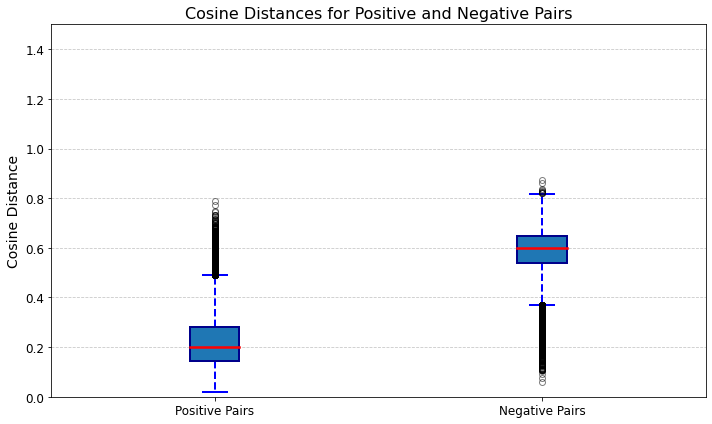

In [52]:
import matplotlib.pyplot as plt
import numpy as np

# Sample cosine distances for positive and negative pairs
# Replace these with your actual data
cosine_distances_positive = positive_cosine_distances#np.random.normal(0.2, 0.05, 100)  # Simulated positive pairs
cosine_distances_negative = negative_cosine_distances#np.random.normal(0.8, 0.05, 100)  # Simulated negative pairs

# Create a box plot
plt.figure(figsize=(10, 6))

# Box plot settings
boxprops = dict(linestyle='-', linewidth=2, color='darkblue')
medianprops = dict(linestyle='-', linewidth=2.5, color='red')
whiskerprops = dict(linestyle='--', linewidth=2, color='blue')
capprops = dict(color='blue', linewidth=2)
flierprops = dict(marker='o', color='green', alpha=0.5)

# Create boxplot with custom settings
plt.boxplot(
    [cosine_distances_positive, cosine_distances_negative],
    labels=['Positive Pairs', 'Negative Pairs'],
    boxprops=boxprops,
    medianprops=medianprops,
    whiskerprops=whiskerprops,
    capprops=capprops,
    flierprops=flierprops,
    patch_artist=True
)

# Beautify the plot
plt.title('Cosine Distances for Positive and Negative Pairs', fontsize=16)
plt.ylabel('Cosine Distance', fontsize=14)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.ylim(0, 1.5)  # Set y-limit for better visualization
plt.tight_layout()

# Show plot
plt.show()


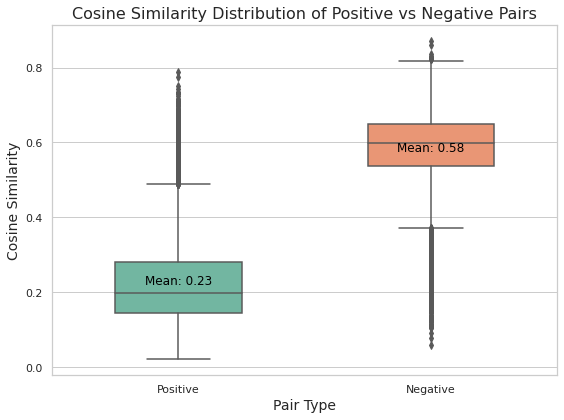

In [72]:
import seaborn as sns
import matplotlib.pyplot as plt

# Example data for positive_pairs and negative_pairs (replace with actual values)
positive_pairs = positive_cosine_distances#[0.95, 0.89, 0.92, 0.96, 0.90, 0.94, 0.91]
negative_pairs = negative_cosine_distances#[0.10, 0.15, 0.12, 0.11, 0.13, 0.14, 0.09]

# Calculate the mean values for each category
mean_positive = data[data['Pair Type'] == 'Positive']['Cosine Values'].mean()
mean_negative = data[data['Pair Type'] == 'Negative']['Cosine Values'].mean()

# Create the box plot using Seaborn
plt.figure(figsize=(8, 6))
sns.set(style="whitegrid")  # Add grid for better visibility

box_plot = sns.boxplot(x='Pair Type', y='Cosine Values', data=data, palette='Set2', width=0.5)

# Add a title and labels
plt.title('Cosine Similarity Distribution of Positive vs Negative Pairs', fontsize=16)
plt.xlabel('Pair Type', fontsize=14)
plt.ylabel('Cosine Similarity', fontsize=14)

# Annotate the mean values on the chart
plt.text(0, mean_positive, f'Mean: {mean_positive:.2f}', color='black', ha='center', va='center', fontsize=12)
plt.text(1, mean_negative, f'Mean: {mean_negative:.2f}', color='black', ha='center', va='center', fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()


In [56]:
positive_df = pd.DataFrame(cosine_distances_positive)#.describe()

In [60]:
positive_df[0].describe()

count    24524.000000
mean         0.228581
std          0.118655
min          0.020555
25%          0.143925
50%          0.198635
75%          0.281832
max          0.789298
Name: 0, dtype: float64

In [58]:
cosine_distances_positive[0]

0.11146247386932373

In [83]:
positive_df[positive_df[0] < 0.05].index

Int64Index([   11,   136,   508,   879,  1106,  2761,  2844,  3345,  3542,
             3648,  3724,  4076,  4323,  4779,  4781,  5033,  5359,  7286,
             8192,  8642,  8714,  9023,  9063,  9223,  9392,  9891, 10176,
            10387, 11514, 11917, 12306, 12785, 13535, 13660, 13876, 14225,
            14304, 14478, 15172, 15979, 16683, 17493, 17764, 18171, 18405,
            19461, 19544, 19840, 19963, 20336, 20369, 20632, 20971, 21065,
            21091, 21866, 22022, 22524, 23013, 23161, 24201],
           dtype='int64')

In [90]:
positive_df[positive_df[0]> 0.5].index[:50]

Int64Index([  86,  112,  119,  157,  162,  173,  198,  235,  248,  249,  266,
             271,  316,  332,  337,  395,  412,  442,  535,  594,  625,  628,
             656,  660,  675,  676,  734,  757,  795,  832,  849,  883,  884,
             898,  925,  947, 1018, 1035, 1055, 1094, 1096, 1146, 1245, 1255,
            1257, 1358, 1379, 1416, 1440, 1453],
           dtype='int64')

In [68]:
positive_test_pairs[21065]

(4602, 4606)

../Dataset/images/059/0598515022.jpg
../Dataset/images/059/0598515031.jpg


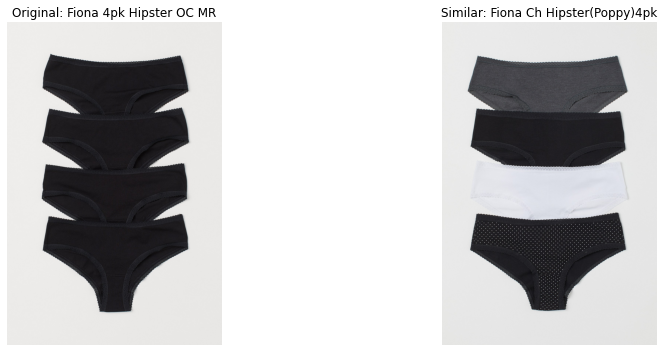

In [69]:
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import torch

# Assuming you already have a list of positive pairs (i, j) and the embeddings are computed
# Also assuming your df has 'image_path' and other relevant columns like 'prod_name'

# Sample: Choose an item index and retrieve its positive pairs
item_index = 4602 # You can choose any item index here
similar_items = [4606]#indices[item_index][:5]  # Get top 5 similar items (indices)

# Prepare to display the original item and its similar items
fig, axes = plt.subplots(1, len(similar_items) + 1, figsize=(15, 5))

# Show the original item
original_item = dataset.iloc[item_index]
print(f"../{original_item['image_path']}")
img = mpimg.imread(f"../{original_item['image_path']}")
axes[0].imshow(img)
axes[0].axis('off')
axes[0].set_title(f"Original: {original_item['prod_name']}")

# Show the similar items
for idx, similar_index in enumerate(similar_items):
    similar_item = dataset.iloc[similar_index]
    print(f"../{similar_item['image_path']}")
    img = mpimg.imread(f"../{similar_item['image_path']}")
    
    axes[idx + 1].imshow(img)
    axes[idx + 1].axis('off')
    axes[idx + 1].set_title(f"Similar: {similar_item['prod_name']}")

plt.tight_layout()
plt.show()


In [79]:
positive_test_pairs[24489]

(5843, 5844)

In [85]:
type(positive_test_pairs)

list

../Dataset/images/070/0708443001.jpg
../Dataset/images/074/0743568001.jpg


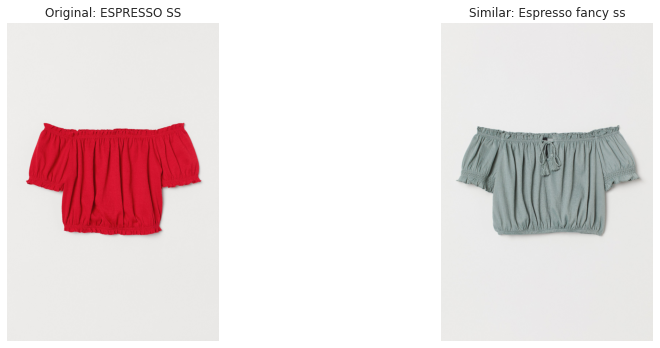

../Dataset/images/083/0832331002.jpg
../Dataset/images/083/0832331003.jpg


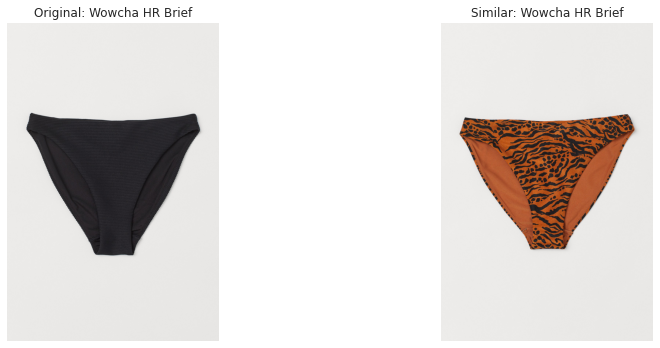

../Dataset/images/078/0783707039.jpg
../Dataset/images/078/0783707012.jpg


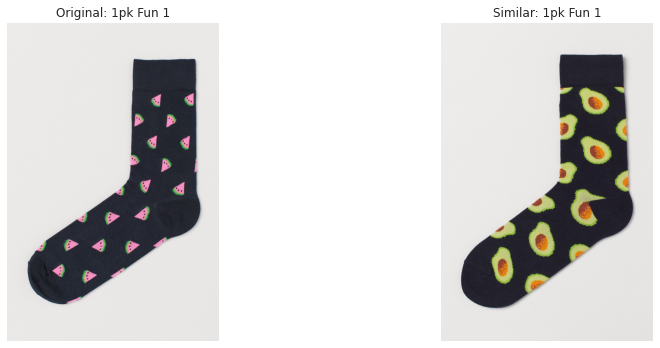

../Dataset/images/054/0546579001.jpg
../Dataset/images/054/0546579003.jpg


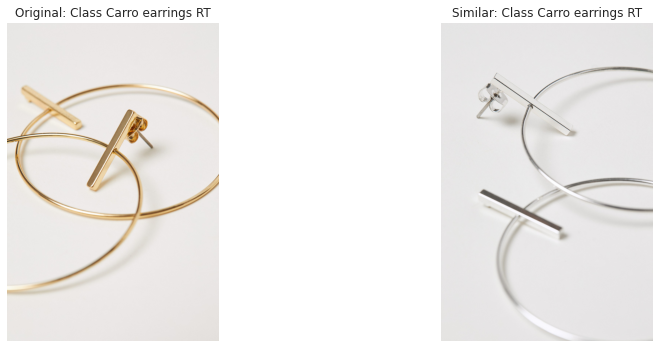

../Dataset/images/080/0806241009.jpg
../Dataset/images/080/0806241004.jpg


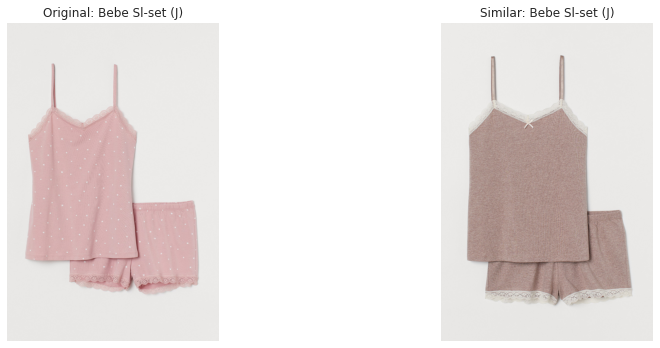

../Dataset/images/090/0902288002.jpg
../Dataset/images/090/0902288003.jpg


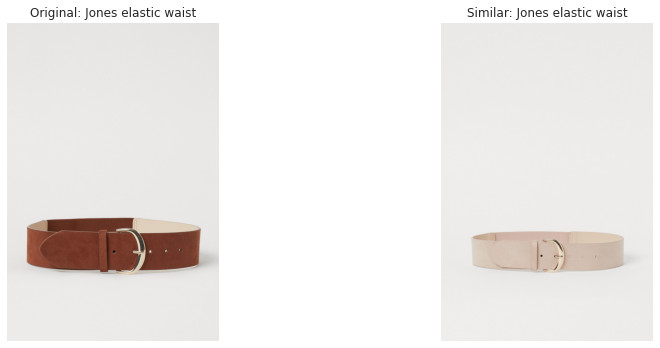

../Dataset/images/080/0807241001.jpg
../Dataset/images/080/0807241017.jpg


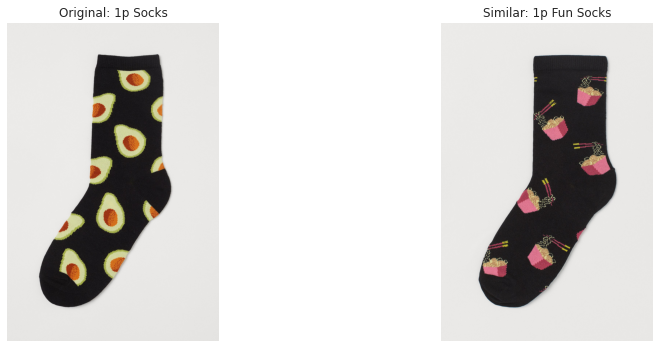

../Dataset/images/078/0781758005.jpg
../Dataset/images/078/0781758004.jpg


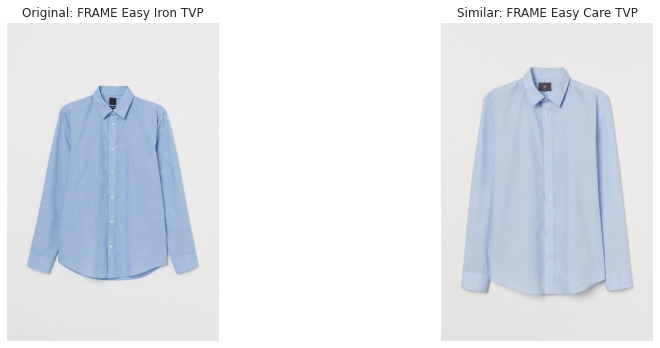

../Dataset/images/059/0598515017.jpg
../Dataset/images/059/0598515016.jpg


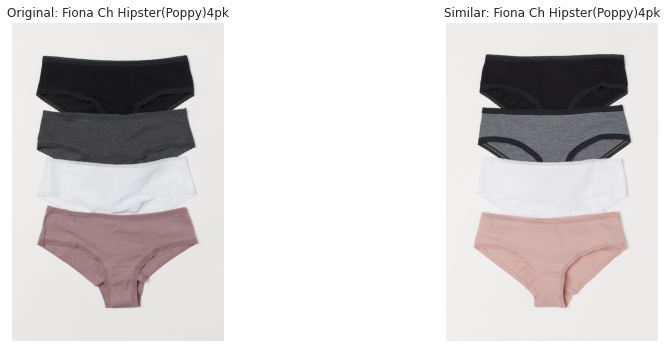

../Dataset/images/078/0783707030.jpg
../Dataset/images/078/0783707050.jpg


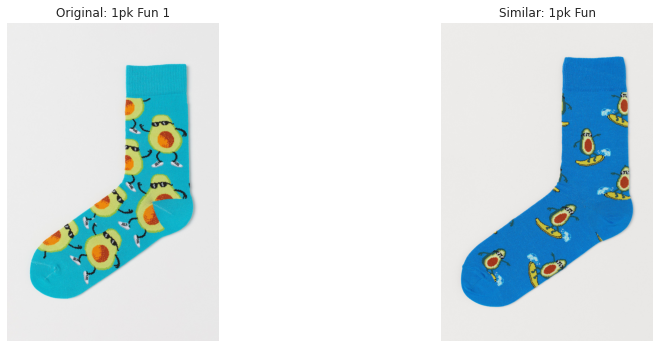

../Dataset/images/063/0632534004.jpg
../Dataset/images/063/0632534006.jpg


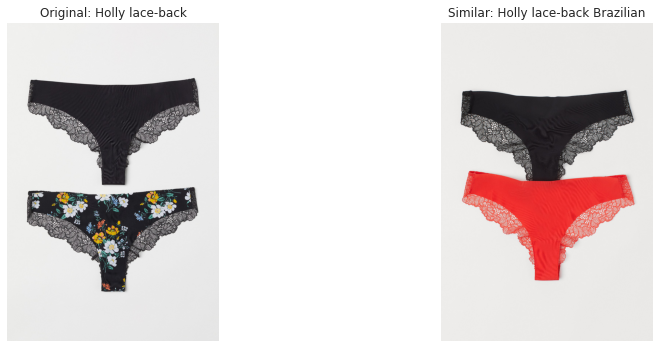

../Dataset/images/068/0688105007.jpg
../Dataset/images/068/0688105012.jpg


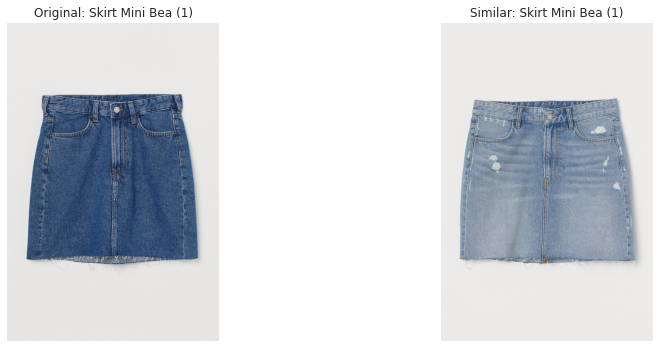

../Dataset/images/078/0789689004.jpg
../Dataset/images/079/0795937001.jpg


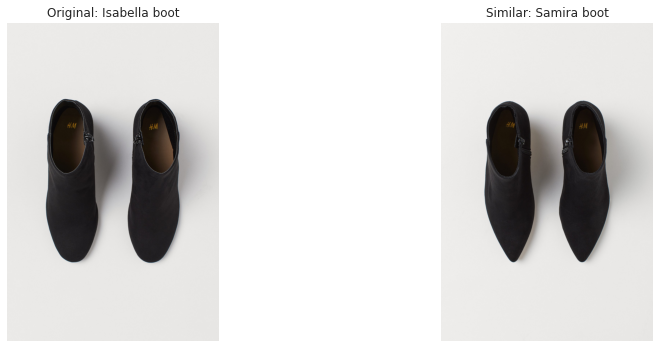

../Dataset/images/085/0859247007.jpg
../Dataset/images/085/0859247001.jpg


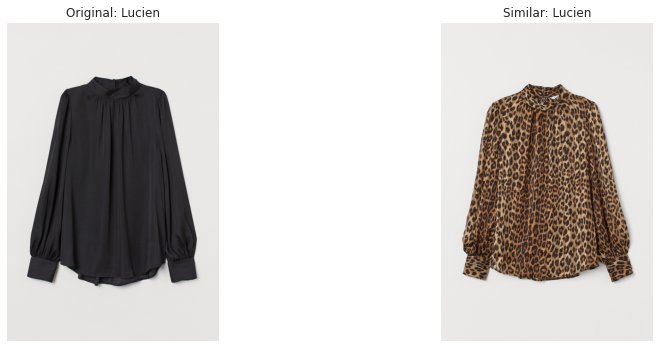

../Dataset/images/070/0706268048.jpg
../Dataset/images/070/0706268014.jpg


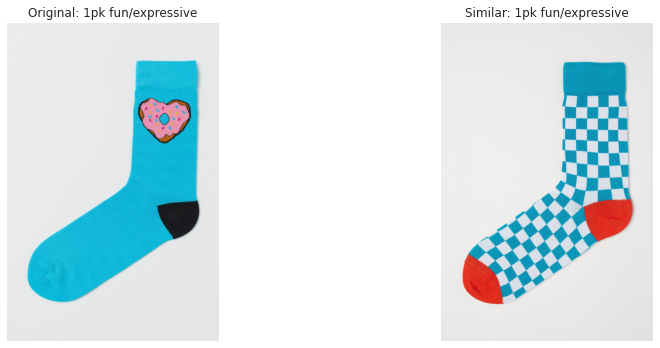

../Dataset/images/068/0680396002.jpg
../Dataset/images/075/0753692017.jpg


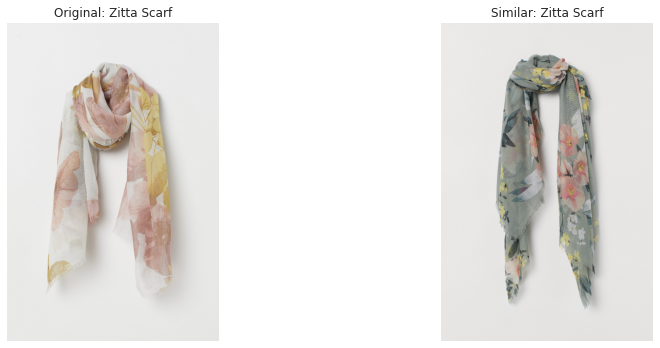

../Dataset/images/059/0594987016.jpg
../Dataset/images/059/0594987024.jpg


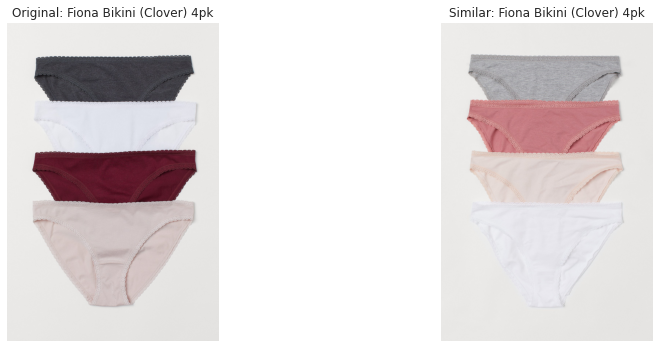

../Dataset/images/045/0456163002.jpg
../Dataset/images/045/0456163062.jpg


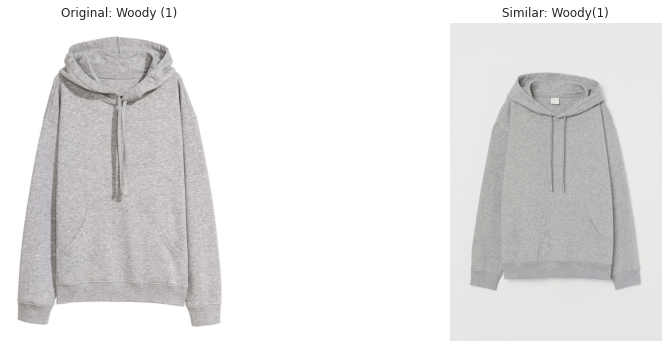

../Dataset/images/085/0854060001.jpg
../Dataset/images/081/0817047002.jpg


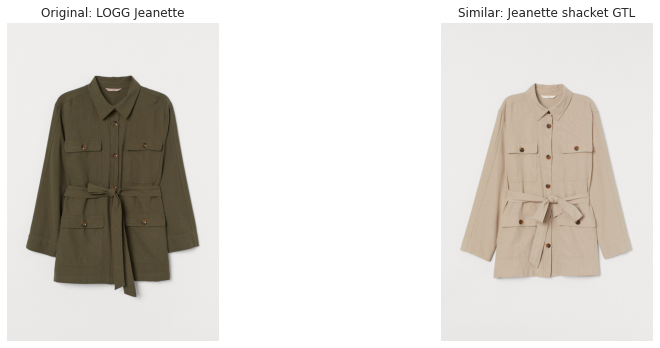

../Dataset/images/059/0594541018.jpg
../Dataset/images/059/0594541019.jpg


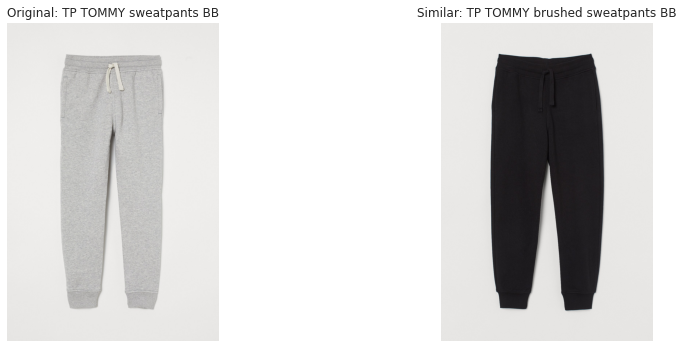

../Dataset/images/070/0701134007.jpg
../Dataset/images/070/0701134016.jpg


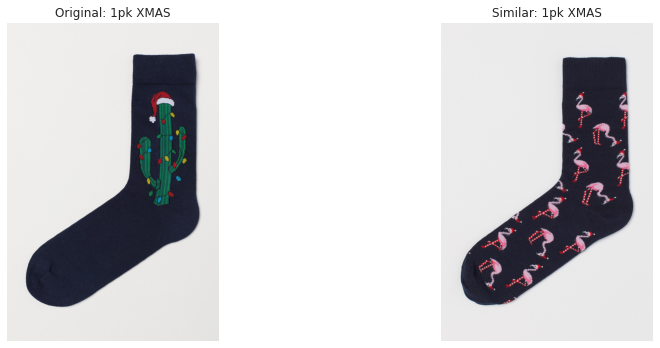

../Dataset/images/068/0685813043.jpg
../Dataset/images/068/0685813005.jpg


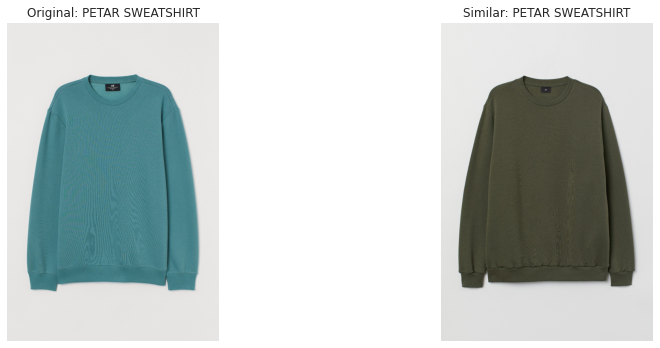

../Dataset/images/077/0778745006.jpg
../Dataset/images/077/0778745010.jpg


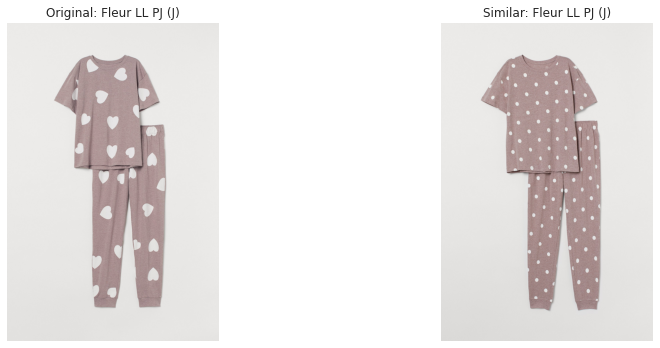

../Dataset/images/080/0809883005.jpg
../Dataset/images/082/0824148001.jpg


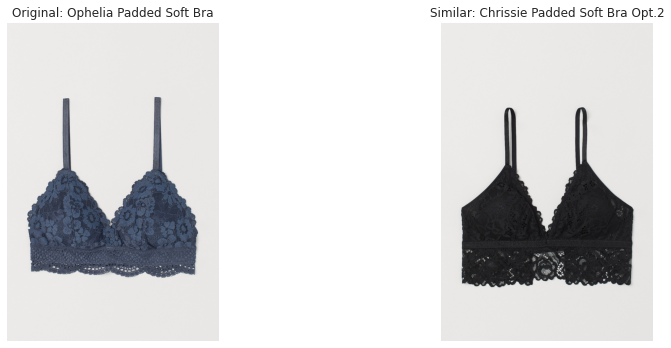

../Dataset/images/048/0488015002.jpg
../Dataset/images/037/0372860024.jpg


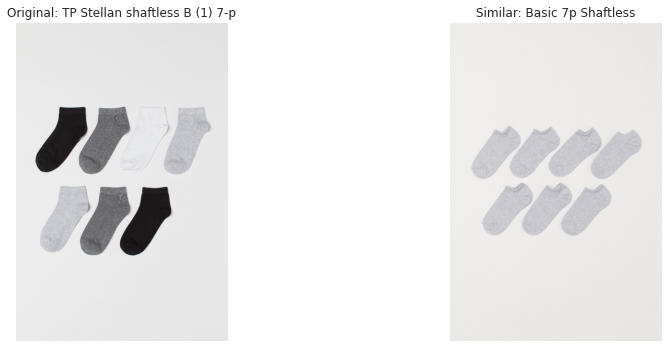

../Dataset/images/068/0685604051.jpg
../Dataset/images/068/0685604027.jpg


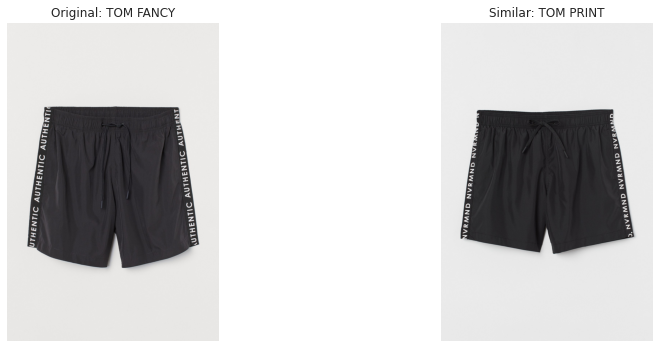

../Dataset/images/082/0821513004.jpg
../Dataset/images/082/0821513005.jpg


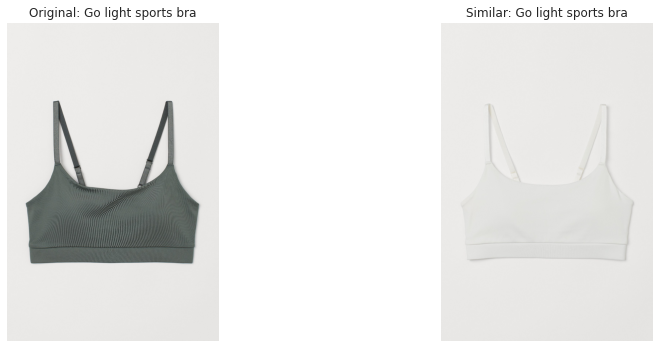

../Dataset/images/074/0743568001.jpg
../Dataset/images/070/0708443001.jpg


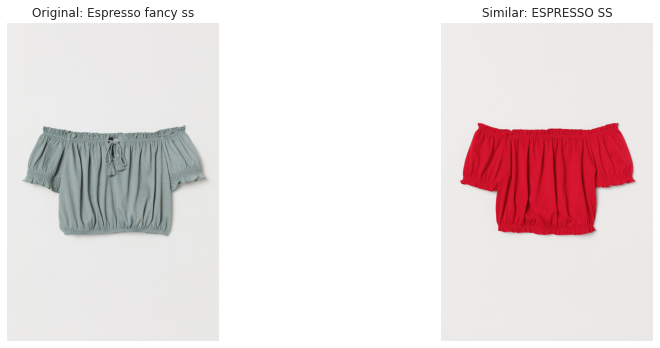

../Dataset/images/072/0723376001.jpg
../Dataset/images/055/0554479017.jpg


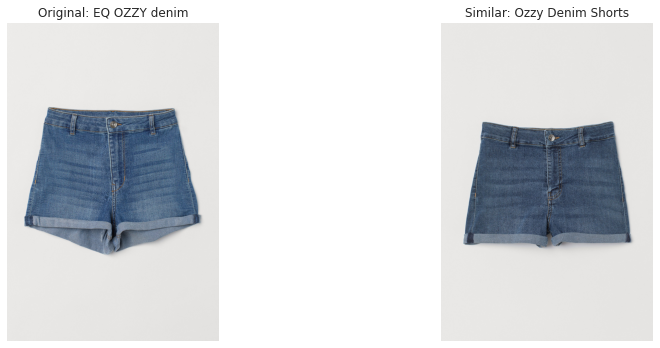

../Dataset/images/080/0807242020.jpg
../Dataset/images/080/0807241016.jpg


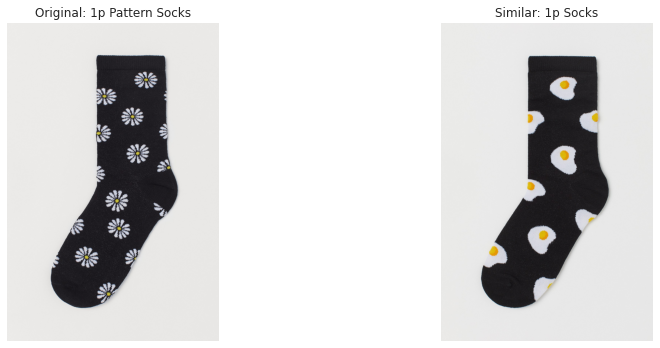

../Dataset/images/055/0559607002.jpg
../Dataset/images/072/0723349003.jpg


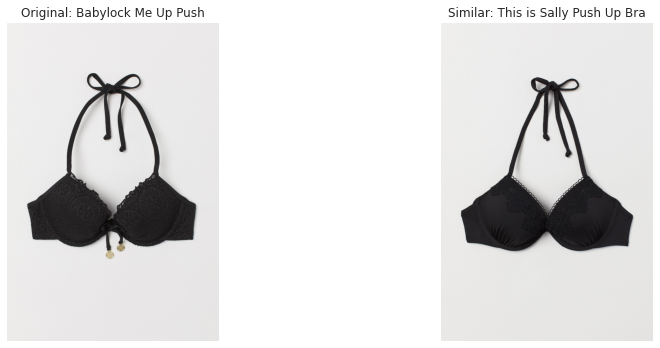

../Dataset/images/083/0834258003.jpg
../Dataset/images/083/0835136002.jpg


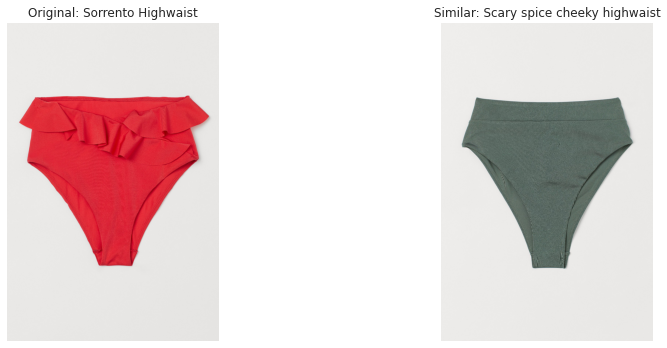

../Dataset/images/079/0792817002.jpg
../Dataset/images/079/0792817003.jpg


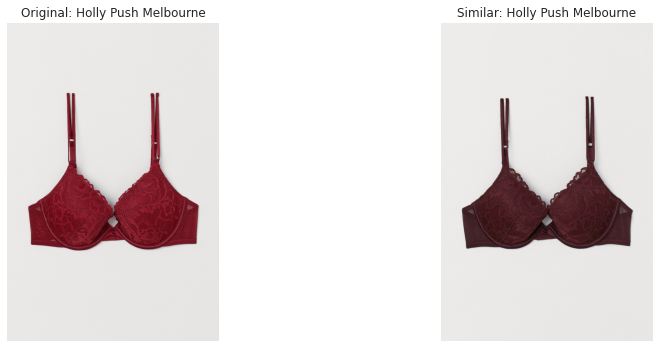

../Dataset/images/074/0749974001.jpg
../Dataset/images/074/0749974003.jpg


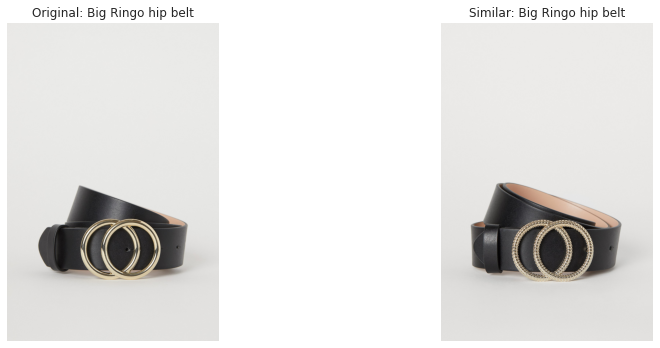

../Dataset/images/073/0735607005.jpg
../Dataset/images/073/0735607004.jpg


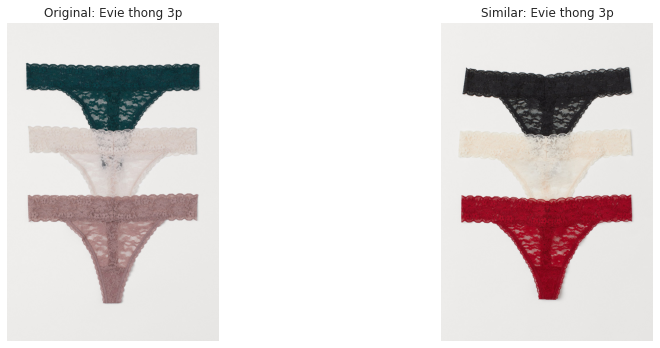

../Dataset/images/077/0771157002.jpg
../Dataset/images/077/0771157003.jpg


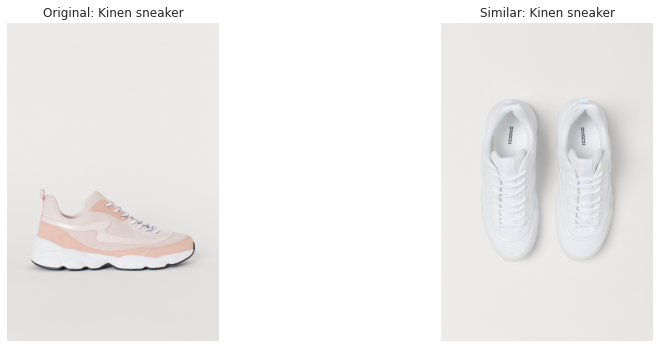

../Dataset/images/075/0754492002.jpg
../Dataset/images/075/0754492001.jpg


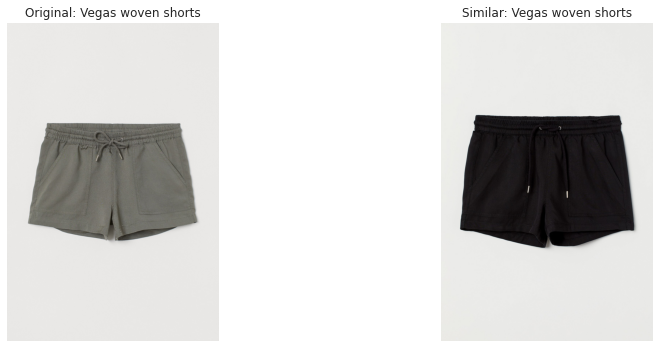

../Dataset/images/088/0885547001.jpg
../Dataset/images/073/0734968001.jpg


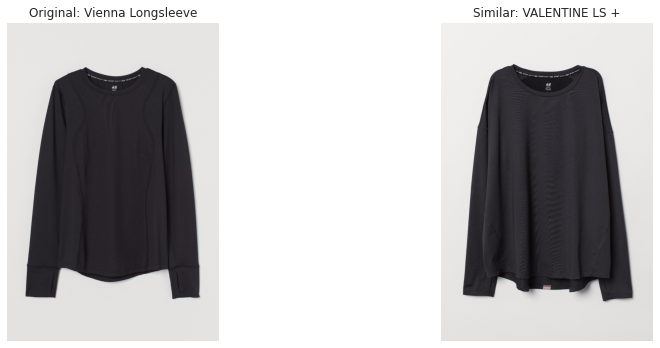

../Dataset/images/066/0660599009.jpg
../Dataset/images/066/0660599007.jpg


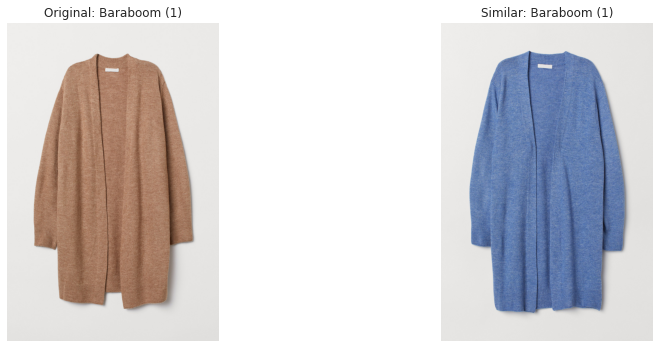

../Dataset/images/082/0827907003.jpg
../Dataset/images/082/0827907012.jpg


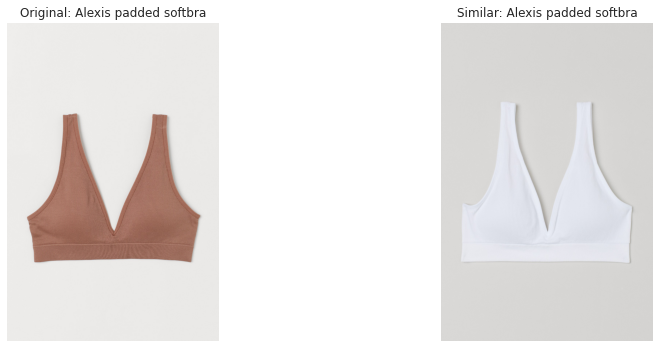

../Dataset/images/061/0614848003.jpg
../Dataset/images/061/0614848001.jpg


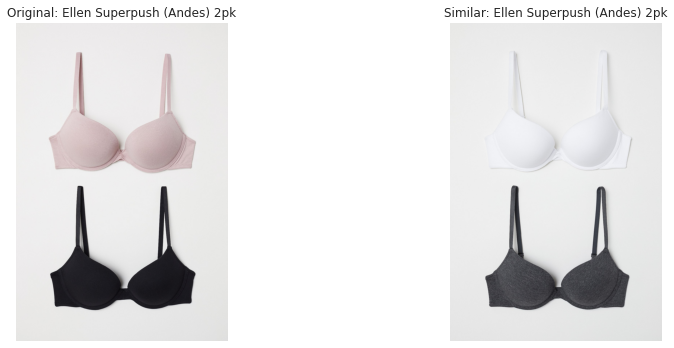

../Dataset/images/058/0589599002.jpg
../Dataset/images/058/0589599016.jpg


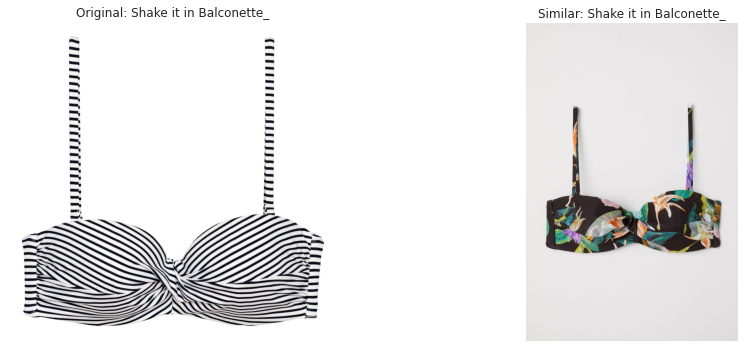

../Dataset/images/084/0846115003.jpg
../Dataset/images/084/0846115001.jpg


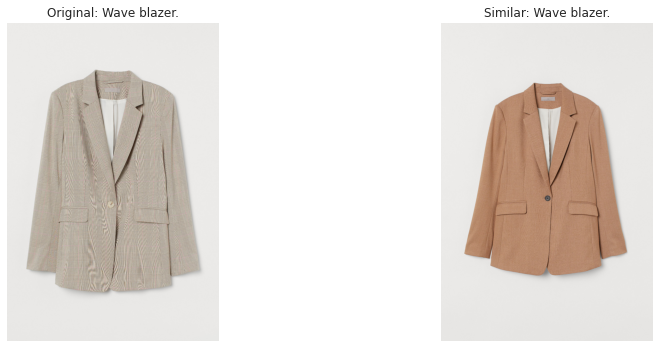

../Dataset/images/073/0733399001.jpg
../Dataset/images/080/0803969003.jpg


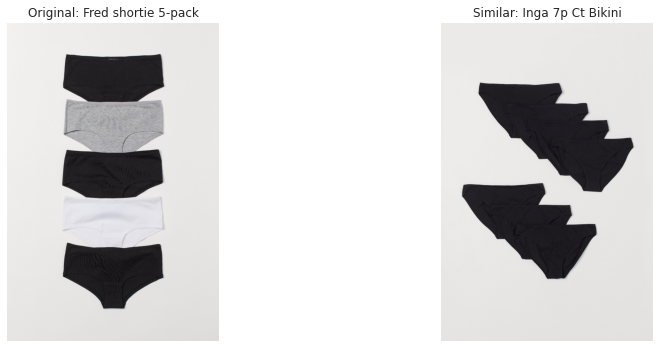

../Dataset/images/062/0621915004.jpg
../Dataset/images/070/0703805001.jpg


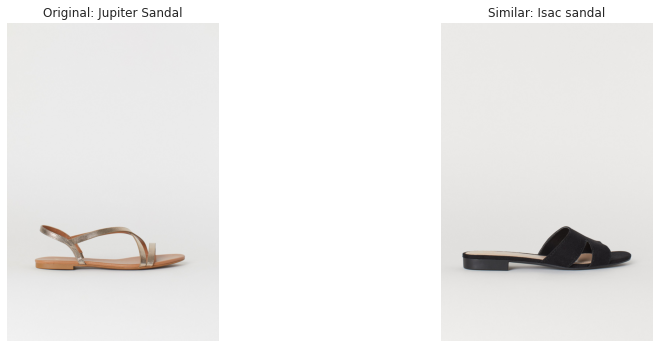

../Dataset/images/078/0783707043.jpg
../Dataset/images/078/0783707045.jpg


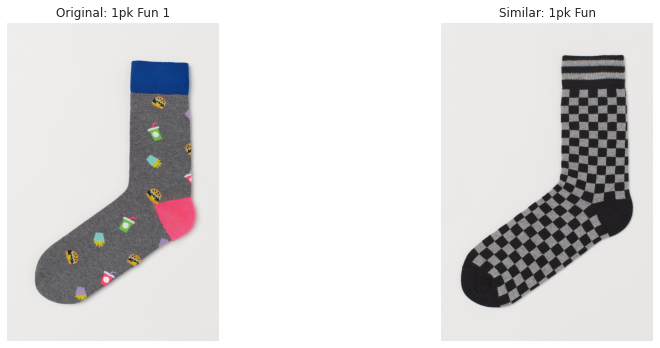

../Dataset/images/061/0614848003.jpg
../Dataset/images/061/0614848005.jpg


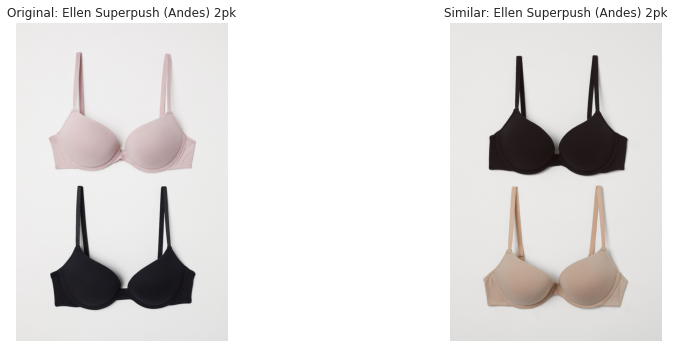

../Dataset/images/066/0661646002.jpg
../Dataset/images/071/0713993001.jpg


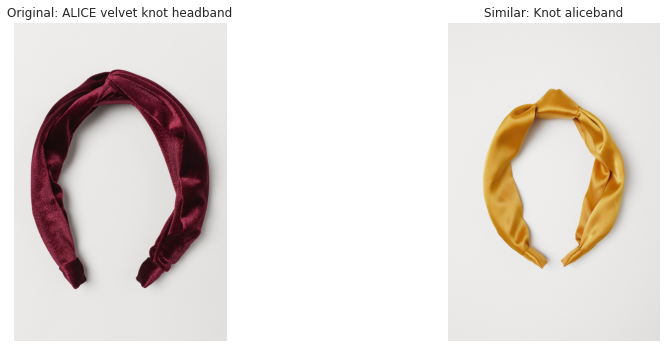

../Dataset/images/085/0853554001.jpg
../Dataset/images/082/0821914001.jpg


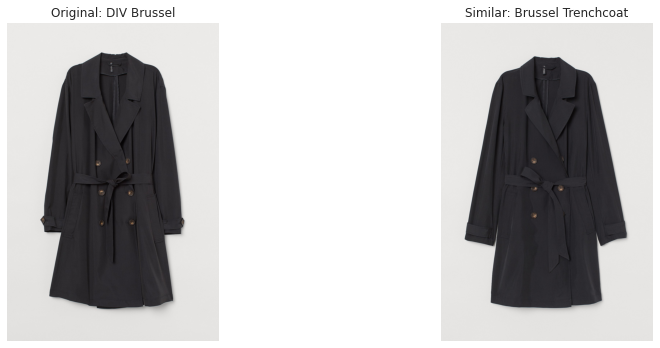

../Dataset/images/059/0598515018.jpg
../Dataset/images/059/0598515028.jpg


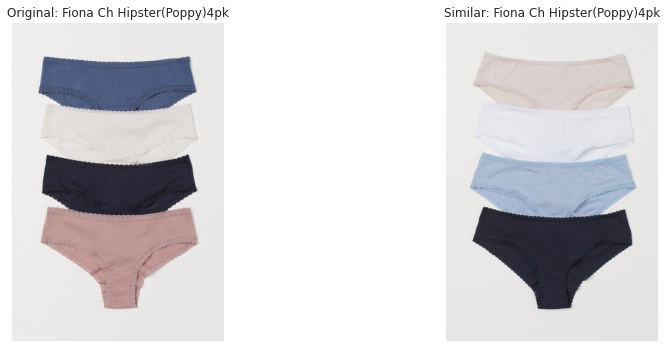

../Dataset/images/090/0906741002.jpg
../Dataset/images/071/0719336001.jpg


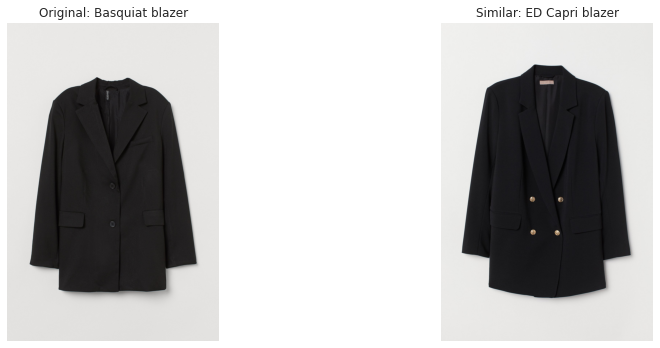

../Dataset/images/078/0781548002.jpg
../Dataset/images/081/0811683003.jpg


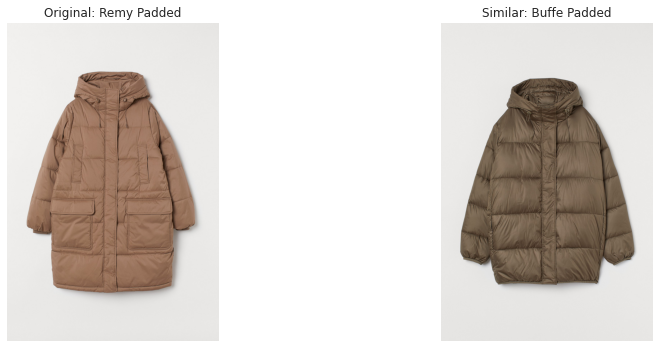

../Dataset/images/057/0579302015.jpg
../Dataset/images/057/0579302013.jpg


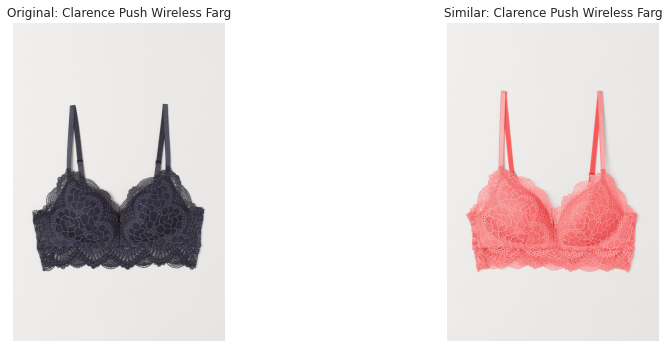

../Dataset/images/059/0598515022.jpg
../Dataset/images/059/0598515031.jpg


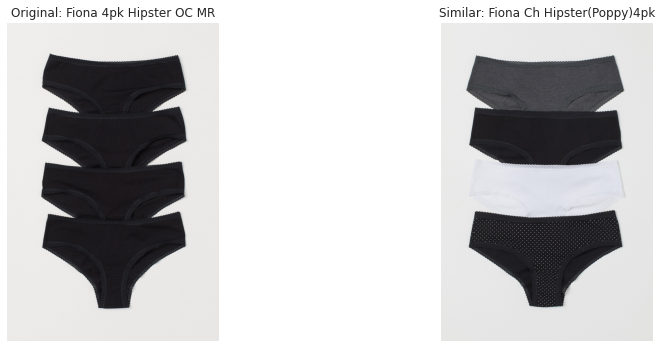

../Dataset/images/077/0777441001.jpg
../Dataset/images/090/0905889002.jpg


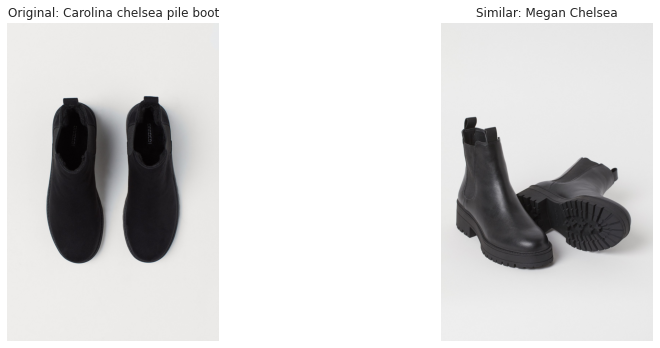

../Dataset/images/059/0590928020.jpg
../Dataset/images/059/0590928013.jpg


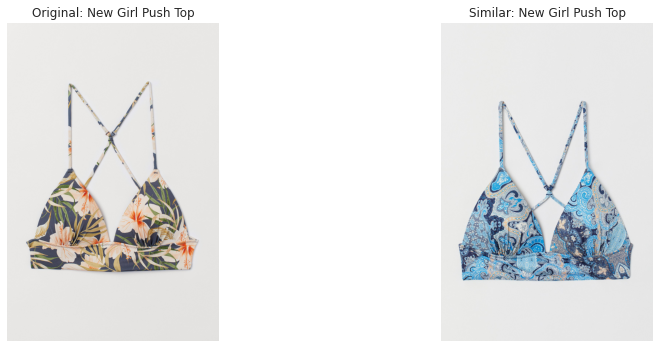

../Dataset/images/068/0688537035.jpg
../Dataset/images/068/0688537026.jpg


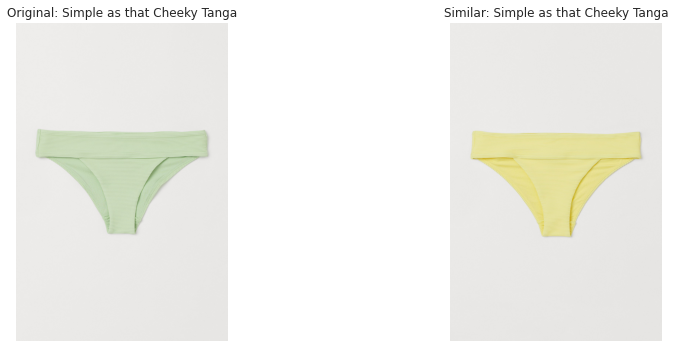

../Dataset/images/069/0692930003.jpg
../Dataset/images/074/0744393002.jpg


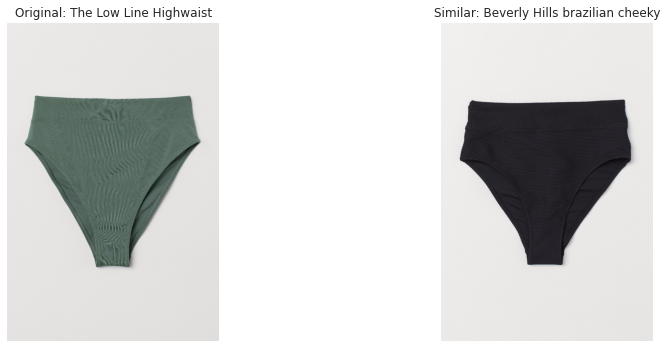

../Dataset/images/077/0774679003.jpg
../Dataset/images/077/0774679002.jpg


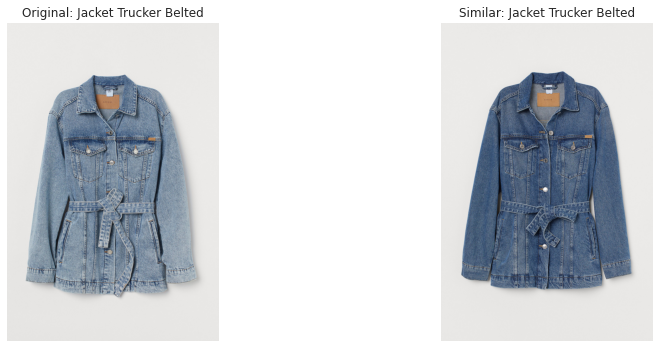

../Dataset/images/070/0708352001.jpg
../Dataset/images/070/0708352002.jpg


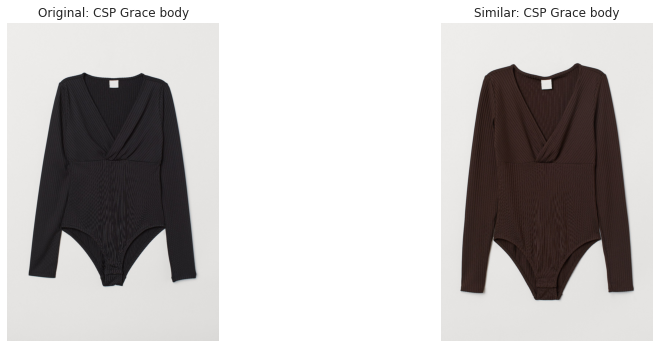

../Dataset/images/049/0490113011.jpg
../Dataset/images/049/0490113014.jpg


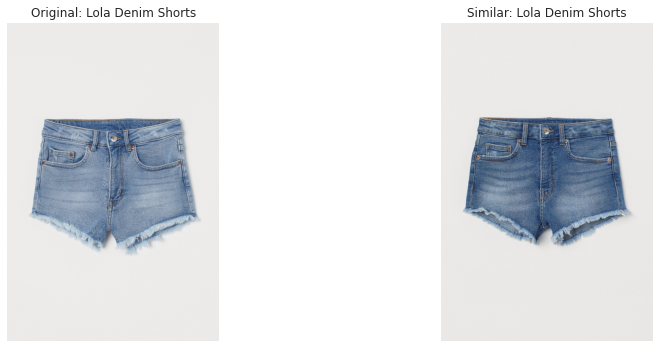

In [88]:
best_matches = [   11,   136,   508,   879,  1106,  2761,  2844,  3345,  3542,
             3648,  3724,  4076,  4323,  4779,  4781,  5033,  5359,  7286,
             8192,  8642,  8714,  9023,  9063,  9223,  9392,  9891, 10176,
            10387, 11514, 11917, 12306, 12785, 13535, 13660, 13876, 14225,
            14304, 14478, 15172, 15979, 16683, 17493, 17764, 18171, 18405,
            19461, 19544, 19840, 19963, 20336, 20369, 20632, 20971, 21065,
            21091, 21866, 22022, 22524, 23013, 23161, 24201]
tup = [positive_test_pairs[match] for match in best_matches]
for item_index, similar_item in tup:

    # Sample: Choose an item index and retrieve its positive pairs
    item_index = item_index # You can choose any item index here
    similar_items = [similar_item]#indices[item_index][:5]  # Get top 5 similar items (indices)

    # Prepare to display the original item and its similar items
    fig, axes = plt.subplots(1, len(similar_items) + 1, figsize=(15, 5))

    # Show the original item
    original_item = dataset.iloc[item_index]
    print(f"../{original_item['image_path']}")
    img = mpimg.imread(f"../{original_item['image_path']}")
    axes[0].imshow(img)
    axes[0].axis('off')
    axes[0].set_title(f"Original: {original_item['prod_name']}")

    # Show the similar items
    for idx, similar_index in enumerate(similar_items):
        similar_item = dataset.iloc[similar_index]
        print(f"../{similar_item['image_path']}")
        img = mpimg.imread(f"../{similar_item['image_path']}")

        axes[idx + 1].imshow(img)
        axes[idx + 1].axis('off')
        axes[idx + 1].set_title(f"Similar: {similar_item['prod_name']}")

    plt.tight_layout()
    plt.show()


../Dataset/images/072/0724216002.jpg
../Dataset/images/081/0818972002.jpg


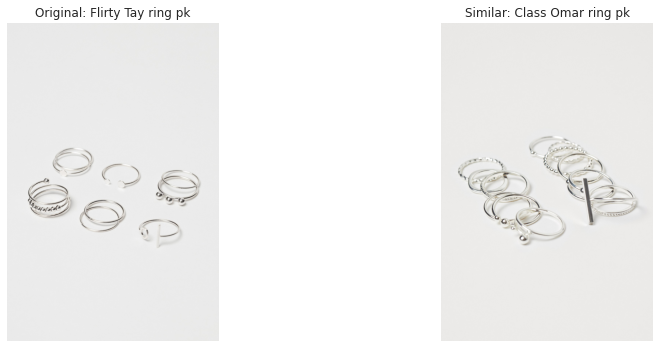

In [74]:


# Sample: Choose an item index and retrieve its positive pairs
item_index = 15027 # You can choose any item index here
similar_items = [24430]#indices[item_index][:5]  # Get top 5 similar items (indices)

# Prepare to display the original item and its similar items
fig, axes = plt.subplots(1, len(similar_items) + 1, figsize=(15, 5))

# Show the original item
original_item = dataset.iloc[item_index]
print(f"../{original_item['image_path']}")
img = mpimg.imread(f"../{original_item['image_path']}")
axes[0].imshow(img)
axes[0].axis('off')
axes[0].set_title(f"Original: {original_item['prod_name']}")

# Show the similar items
for idx, similar_index in enumerate(similar_items):
    similar_item = dataset.iloc[similar_index]
    print(f"../{similar_item['image_path']}")
    img = mpimg.imread(f"../{similar_item['image_path']}")
    
    axes[idx + 1].imshow(img)
    axes[idx + 1].axis('off')
    axes[idx + 1].set_title(f"Similar: {similar_item['prod_name']}")

plt.tight_layout()
plt.show()


../Dataset/images/079/0793506001.jpg
../Dataset/images/079/0793506015.jpg


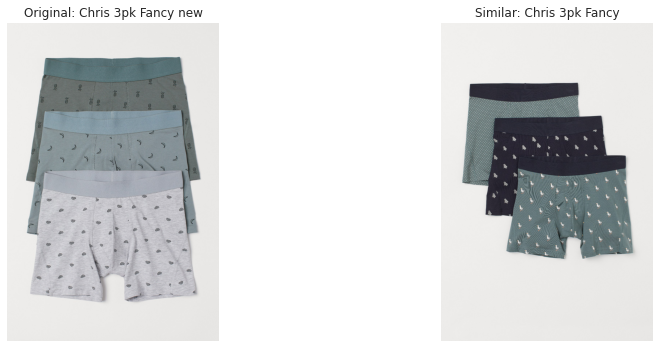

In [76]:


# Sample: Choose an item index and retrieve its positive pairs
item_index = 22106 # You can choose any item index here
similar_items = [22109]#indices[item_index][:5]  # Get top 5 similar items (indices)

# Prepare to display the original item and its similar items
fig, axes = plt.subplots(1, len(similar_items) + 1, figsize=(15, 5))

# Show the original item
original_item = dataset.iloc[item_index]
print(f"../{original_item['image_path']}")
img = mpimg.imread(f"../{original_item['image_path']}")
axes[0].imshow(img)
axes[0].axis('off')
axes[0].set_title(f"Original: {original_item['prod_name']}")

# Show the similar items
for idx, similar_index in enumerate(similar_items):
    similar_item = dataset.iloc[similar_index]
    print(f"../{similar_item['image_path']}")
    img = mpimg.imread(f"../{similar_item['image_path']}")
    
    axes[idx + 1].imshow(img)
    axes[idx + 1].axis('off')
    axes[idx + 1].set_title(f"Similar: {similar_item['prod_name']}")

plt.tight_layout()
plt.show()


../Dataset/images/076/0761328002.jpg
../Dataset/images/088/0880278001.jpg


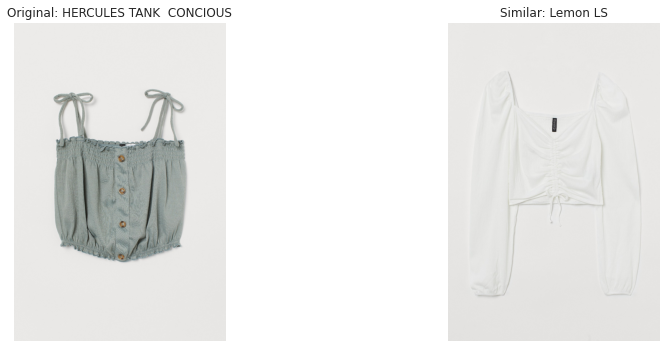

../Dataset/images/059/0597424001.jpg
../Dataset/images/070/0707470002.jpg


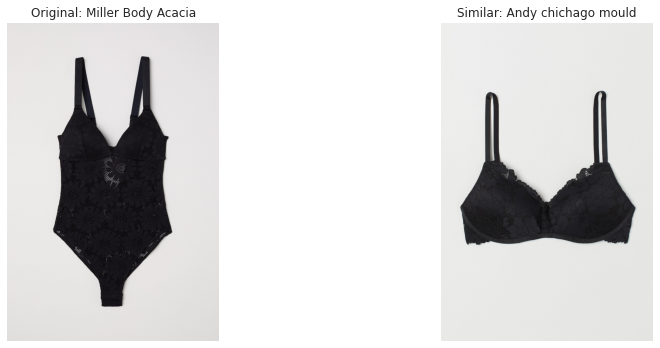

../Dataset/images/079/0798997001.jpg
../Dataset/images/067/0675689003.jpg


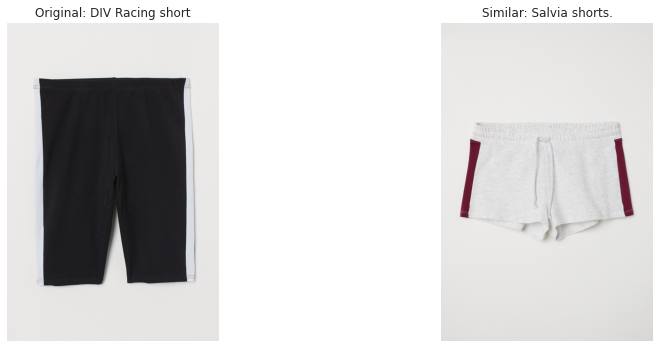

../Dataset/images/076/0769829002.jpg
../Dataset/images/088/0888843001.jpg


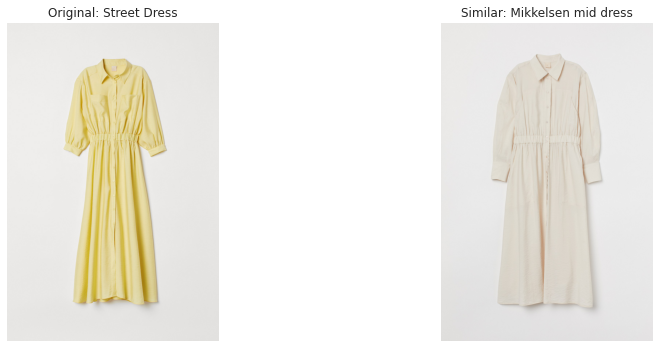

../Dataset/images/075/0758222002.jpg
../Dataset/images/080/0806388011.jpg


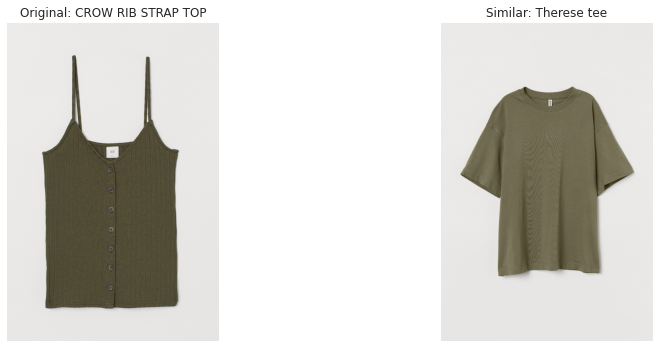

../Dataset/images/079/0793378003.jpg
../Dataset/images/079/0793378002.jpg


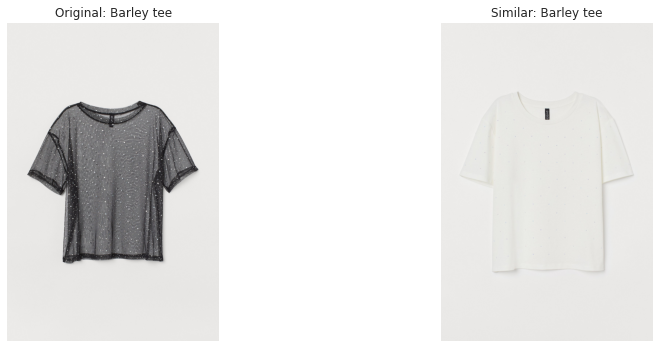

../Dataset/images/063/0637230001.jpg
../Dataset/images/085/0857924002.jpg


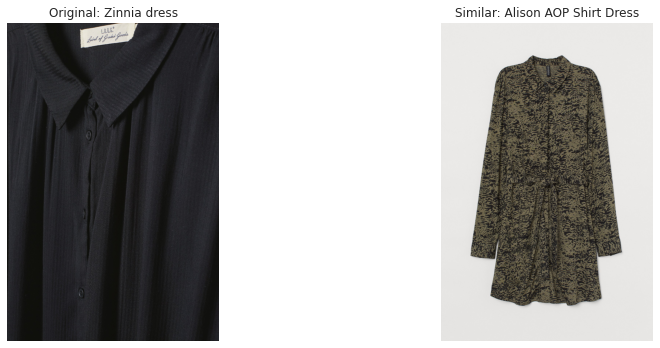

../Dataset/images/048/0487262003.jpg
../Dataset/images/073/0732874001.jpg


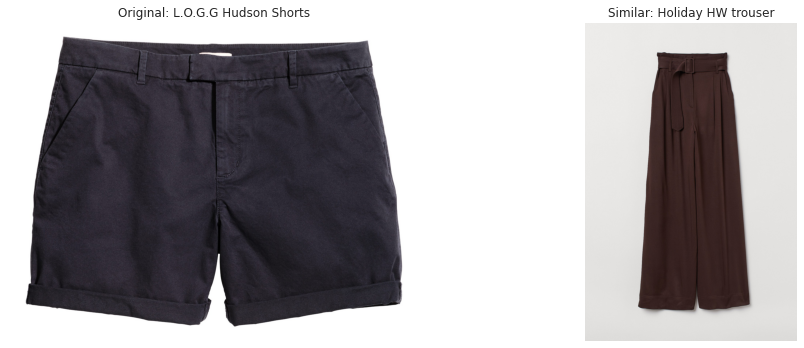

../Dataset/images/080/0808229001.jpg
../Dataset/images/088/0884319001.jpg


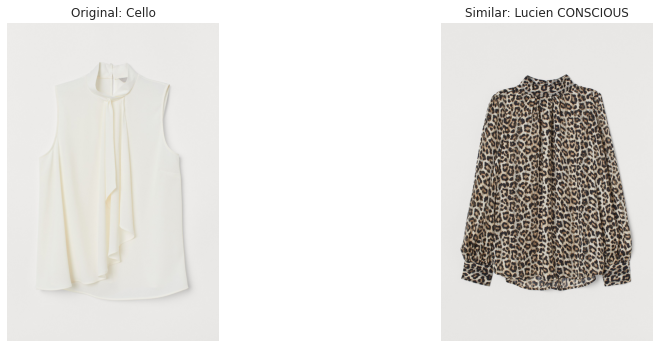

../Dataset/images/074/0749084001.jpg
../Dataset/images/083/0830365003.jpg


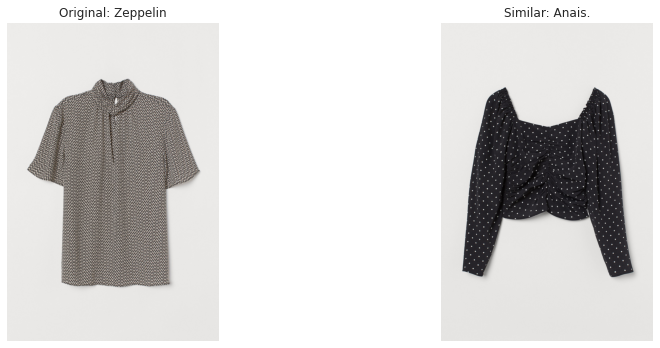

../Dataset/images/064/0643987001.jpg
../Dataset/images/077/0771116006.jpg


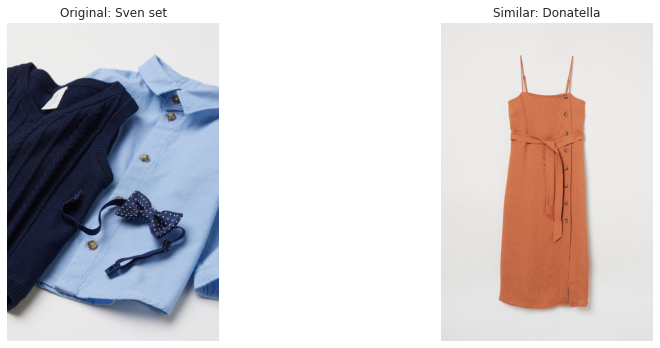

../Dataset/images/050/0501616012.jpg
../Dataset/images/050/0501616048.jpg


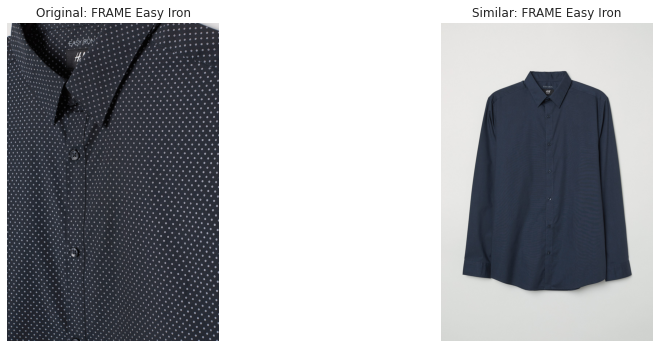

../Dataset/images/065/0659381001.jpg
../Dataset/images/071/0713708003.jpg


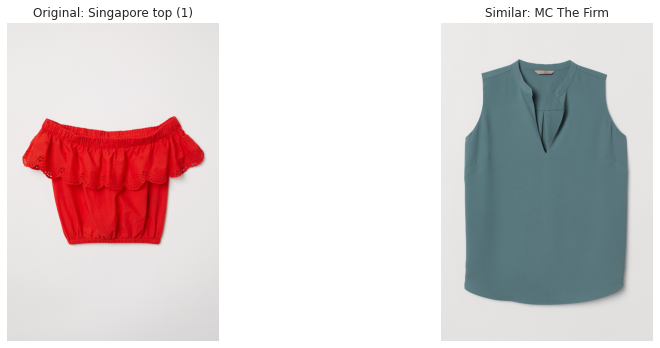

../Dataset/images/069/0693500001.jpg
../Dataset/images/068/0688037004.jpg


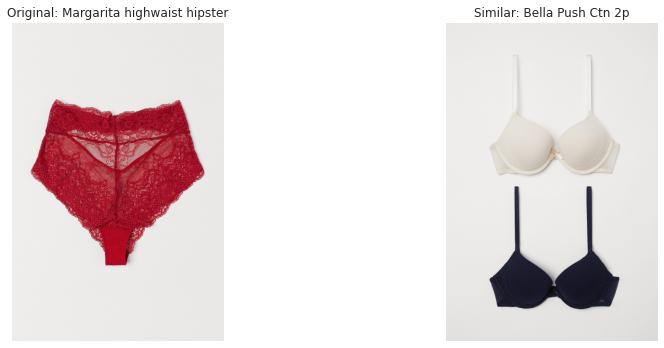

../Dataset/images/077/0771337001.jpg
../Dataset/images/074/0746509004.jpg


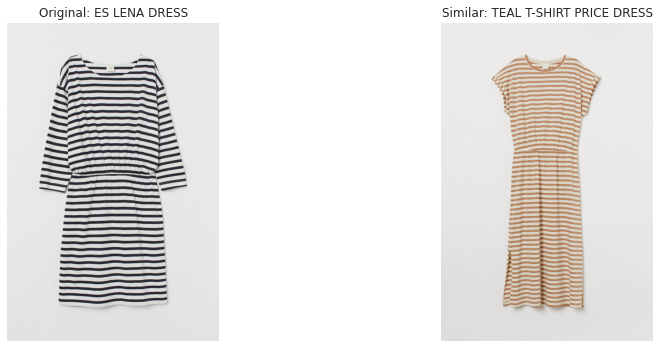

../Dataset/images/087/0878629001.jpg
../Dataset/images/073/0737543004.jpg


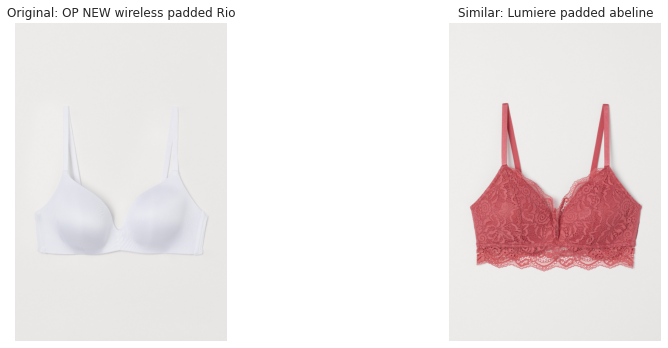

../Dataset/images/077/0771263001.jpg
../Dataset/images/082/0828465001.jpg


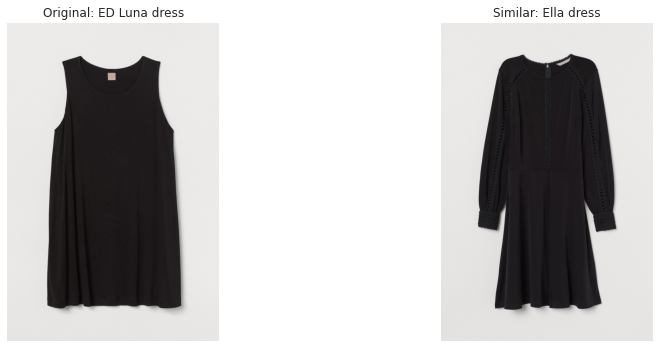

../Dataset/images/061/0617534015.jpg
../Dataset/images/071/0712801001.jpg


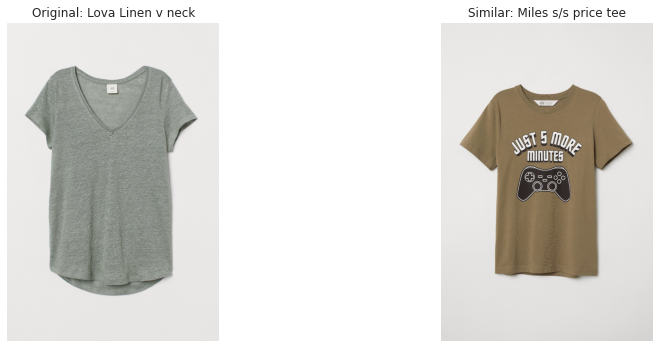

../Dataset/images/083/0831809001.jpg
../Dataset/images/067/0678558002.jpg


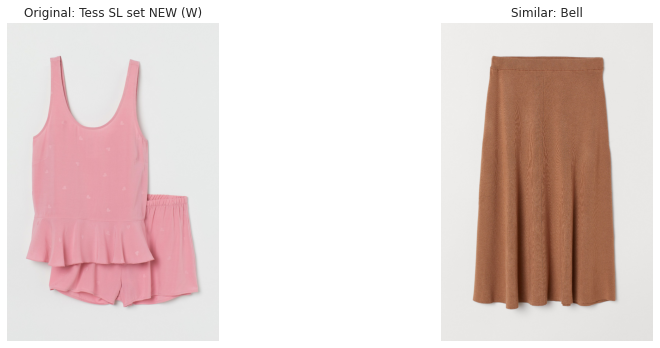

../Dataset/images/062/0620951001.jpg
../Dataset/images/061/0612481007.jpg


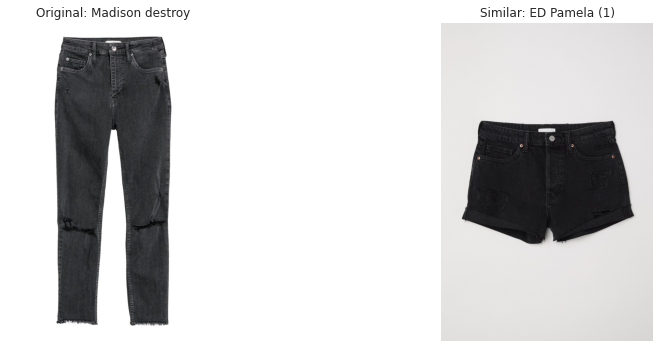

../Dataset/images/059/0595928005.jpg
../Dataset/images/072/0723669002.jpg


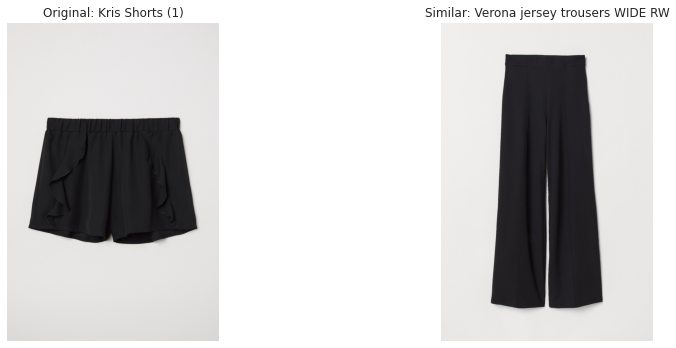

../Dataset/images/076/0763518001.jpg
../Dataset/images/079/0797569001.jpg


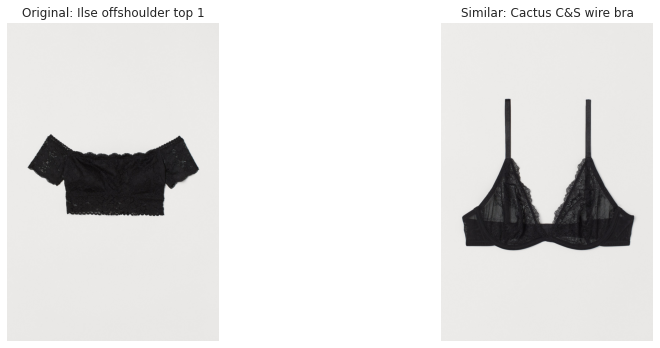

../Dataset/images/058/0587228002.jpg
../Dataset/images/058/0587228001.jpg


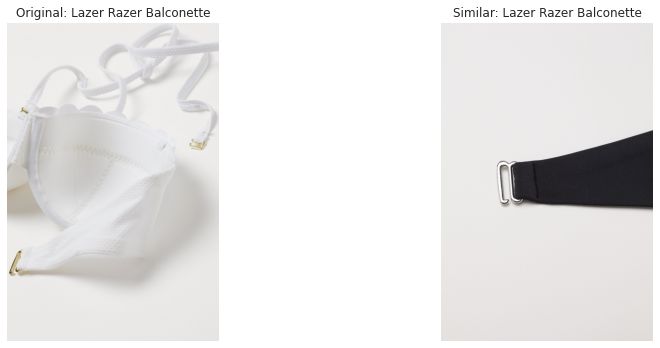

../Dataset/images/089/0894457001.jpg
../Dataset/images/076/0762615001.jpg


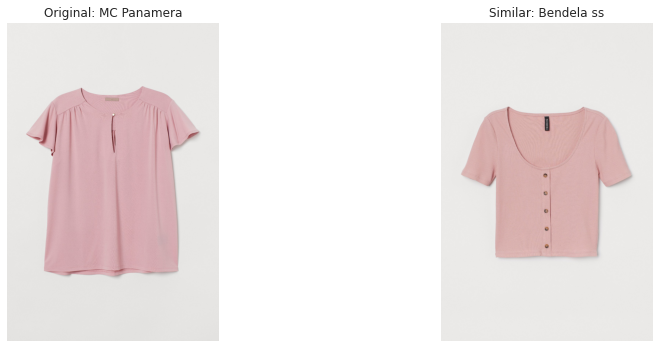

../Dataset/images/079/0799413001.jpg
../Dataset/images/086/0864013001.jpg


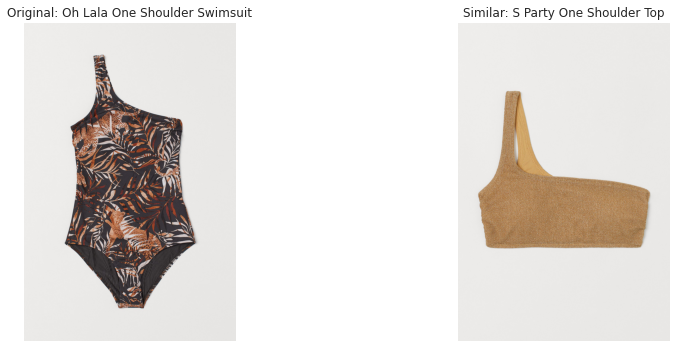

../Dataset/images/084/0845023002.jpg
../Dataset/images/086/0862325001.jpg


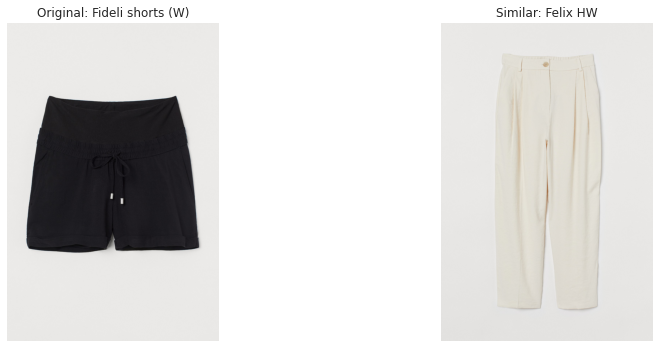

../Dataset/images/076/0761432001.jpg
../Dataset/images/076/0762133002.jpg


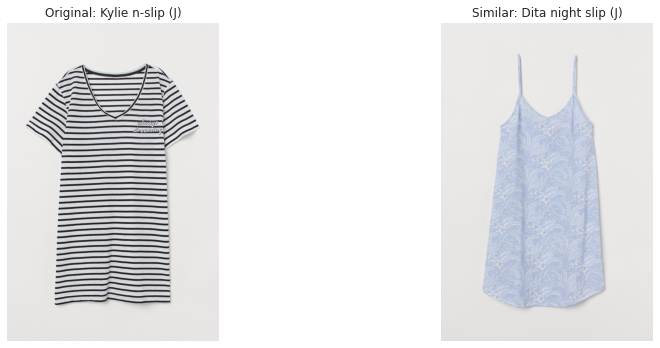

../Dataset/images/076/0766178001.jpg
../Dataset/images/083/0838823003.jpg


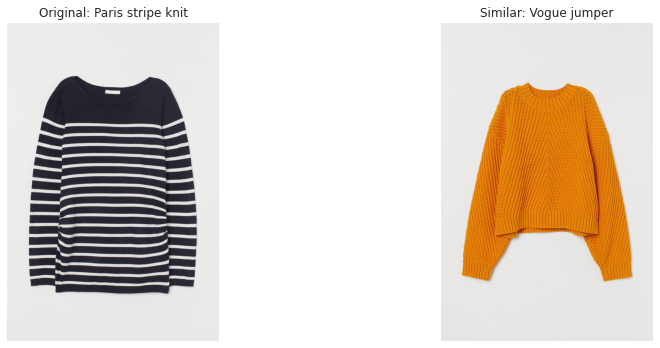

../Dataset/images/072/0721589001.jpg
../Dataset/images/061/0612891008.jpg


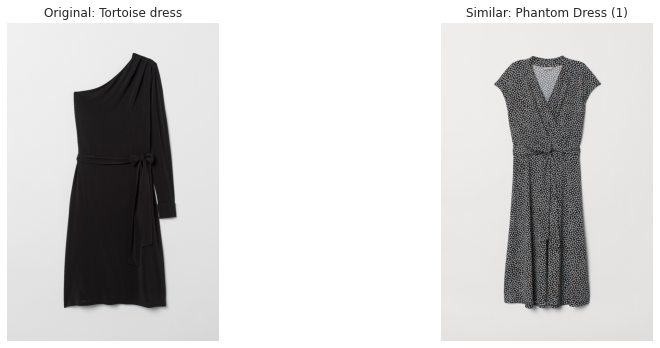

../Dataset/images/082/0823063001.jpg
../Dataset/images/080/0803662001.jpg


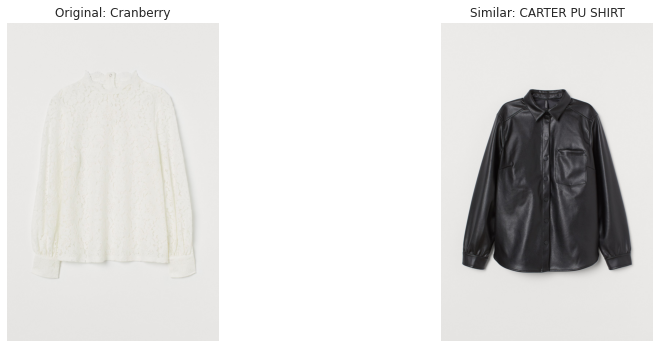

../Dataset/images/071/0719272001.jpg
../Dataset/images/082/0825005001.jpg


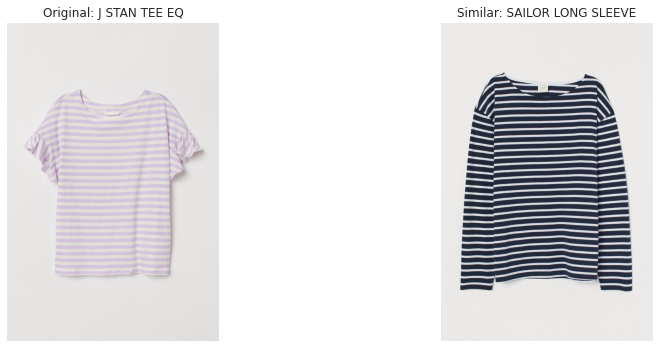

../Dataset/images/071/0715542002.jpg
../Dataset/images/080/0806963003.jpg


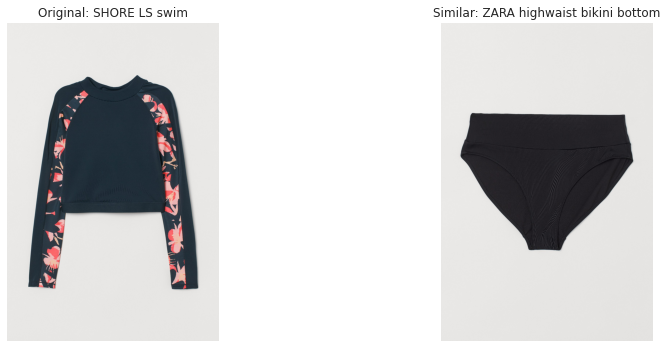

../Dataset/images/073/0736677001.jpg
../Dataset/images/061/0615092002.jpg


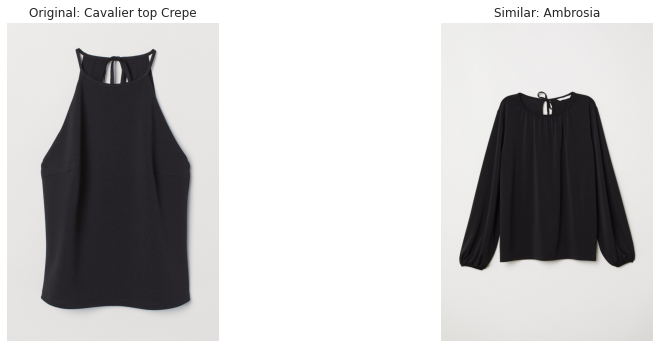

../Dataset/images/079/0790167004.jpg
../Dataset/images/071/0711028004.jpg


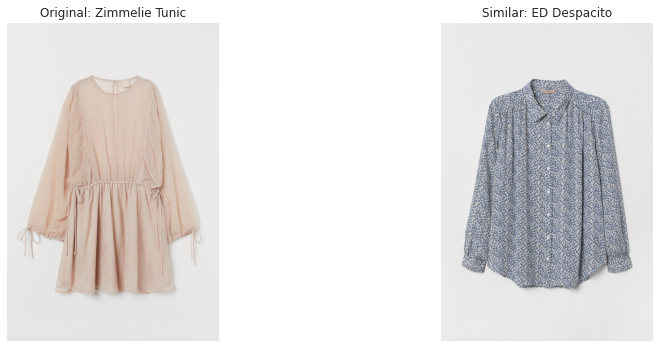

../Dataset/images/067/0671515003.jpg
../Dataset/images/083/0830417001.jpg


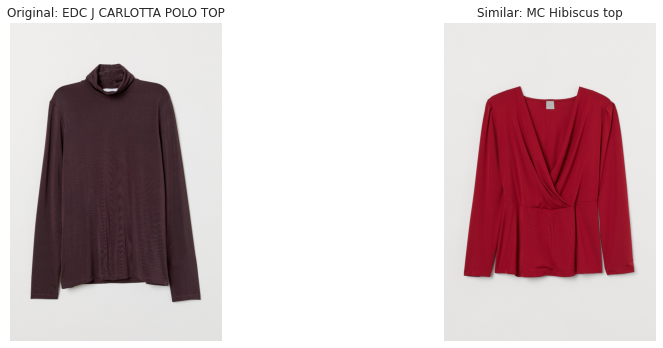

../Dataset/images/083/0837114001.jpg
../Dataset/images/069/0698899003.jpg


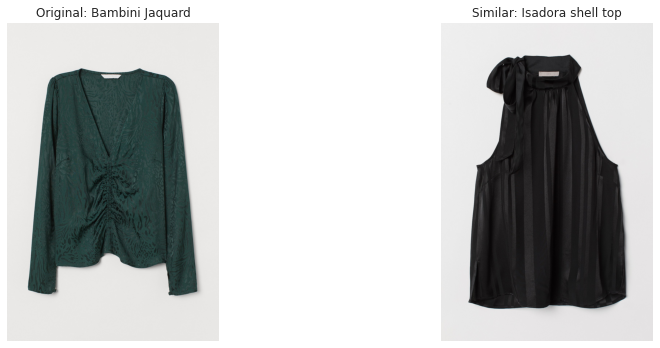

../Dataset/images/079/0796046001.jpg
../Dataset/images/088/0886225001.jpg


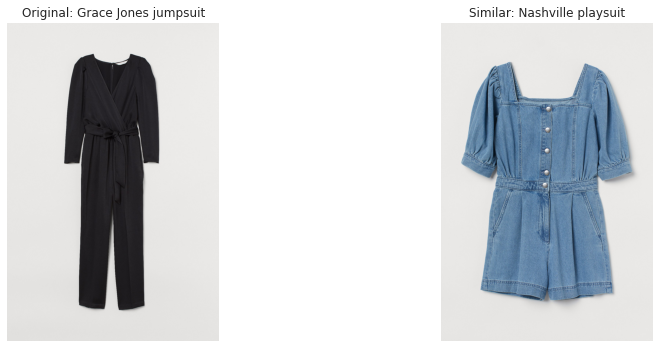

../Dataset/images/064/0646067002.jpg
../Dataset/images/084/0846327005.jpg


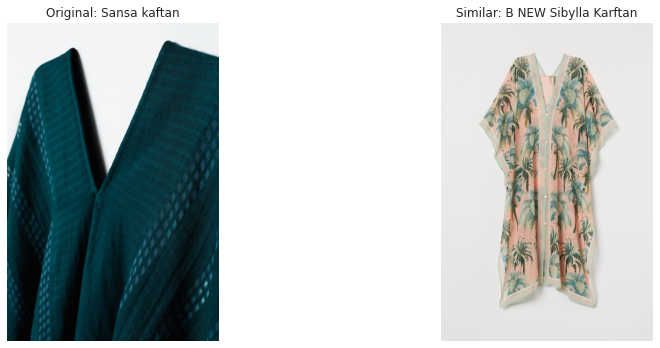

../Dataset/images/070/0709026002.jpg
../Dataset/images/071/0718549003.jpg


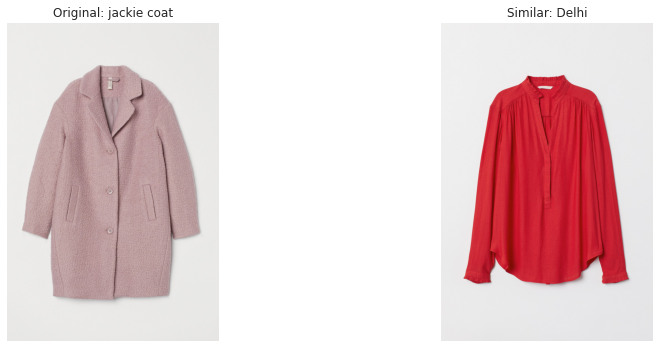

../Dataset/images/080/0809798001.jpg
../Dataset/images/071/0715052003.jpg


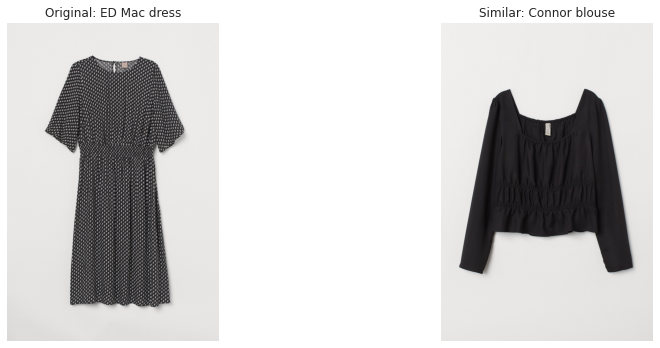

../Dataset/images/049/0490794024.jpg
../Dataset/images/075/0754267050.jpg


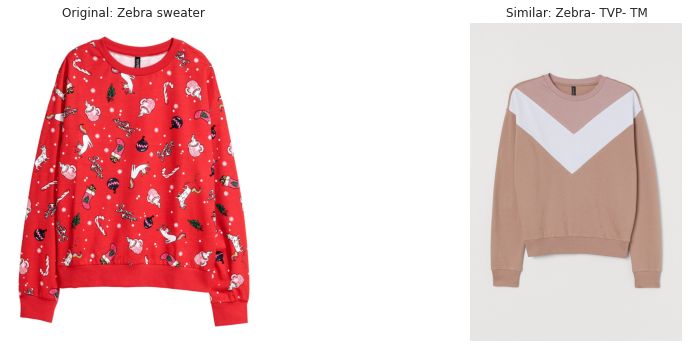

../Dataset/images/063/0634321002.jpg
../Dataset/images/081/0811660001.jpg


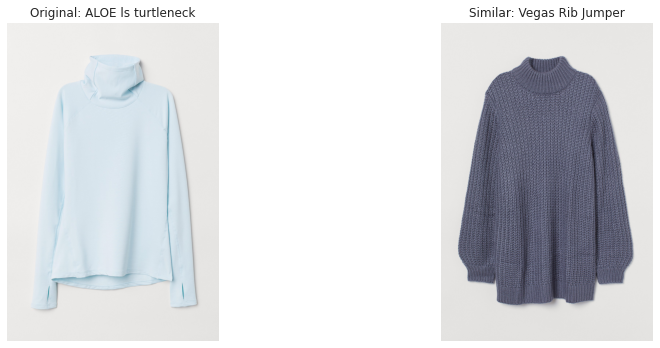

../Dataset/images/084/0840567001.jpg
../Dataset/images/081/0818329001.jpg


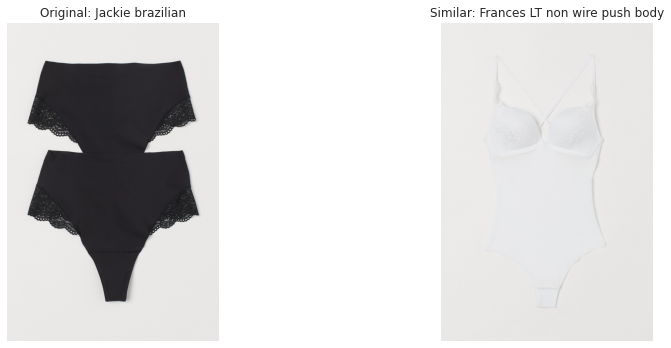

../Dataset/images/092/0924040001.jpg
../Dataset/images/086/0865261001.jpg


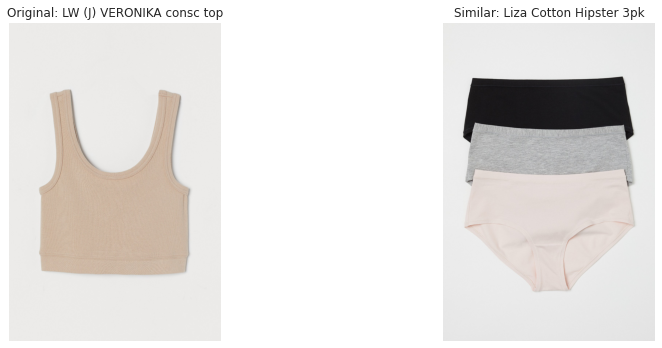

../Dataset/images/063/0633172007.jpg
../Dataset/images/079/0790973001.jpg


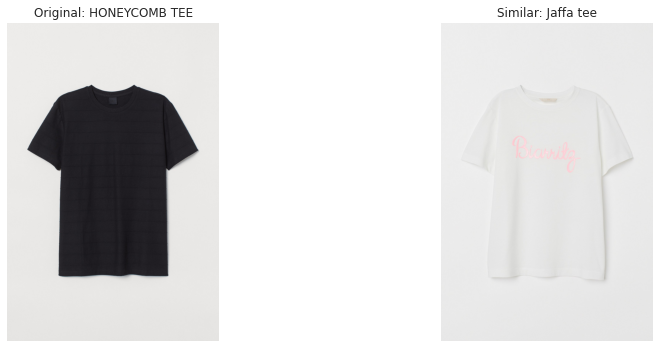

../Dataset/images/070/0700835002.jpg
../Dataset/images/068/0685429001.jpg


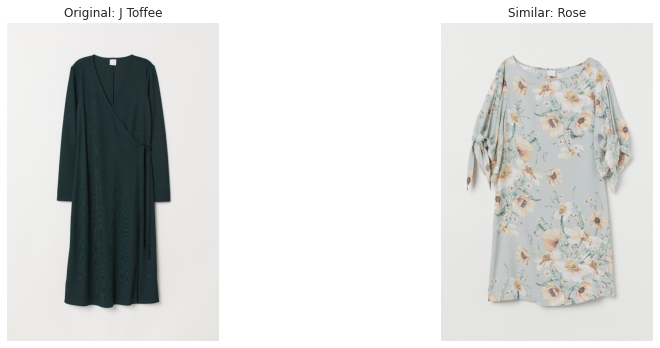

../Dataset/images/078/0789304003.jpg
../Dataset/images/090/0902362001.jpg


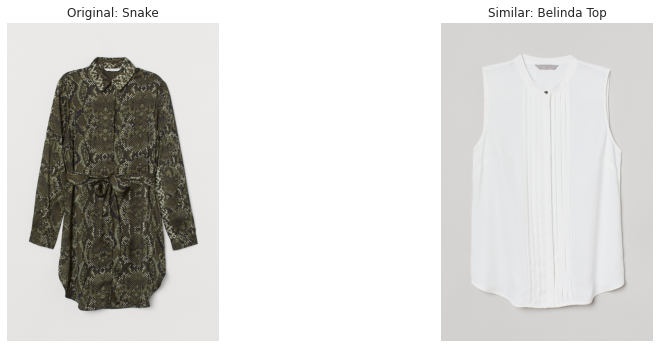

../Dataset/images/067/0673643002.jpg
../Dataset/images/071/0711727004.jpg


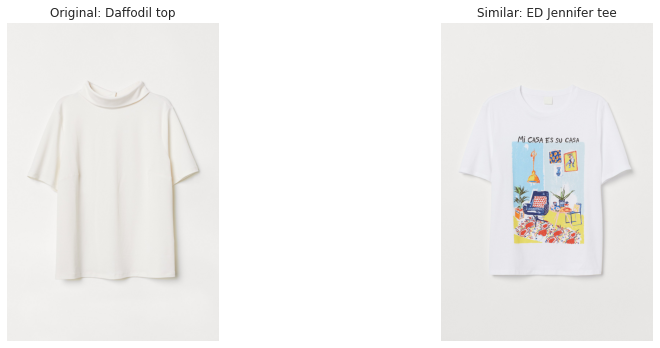

../Dataset/images/081/0819259001.jpg
../Dataset/images/075/0758034001.jpg


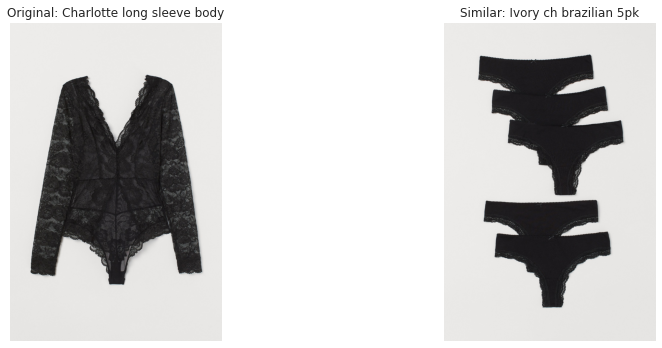

../Dataset/images/076/0769032001.jpg
../Dataset/images/081/0811705001.jpg


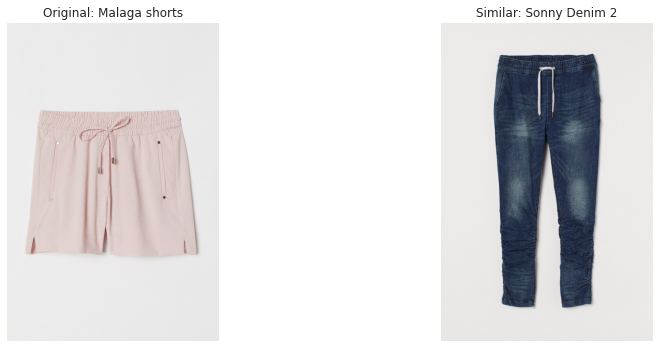

In [91]:


worst_positives = [  86,  112,  119,  157,  162,  173,  198,  235,  248,  249,  266,
             271,  316,  332,  337,  395,  412,  442,  535,  594,  625,  628,
             656,  660,  675,  676,  734,  757,  795,  832,  849,  883,  884,
             898,  925,  947, 1018, 1035, 1055, 1094, 1096, 1146, 1245, 1255,
            1257, 1358, 1379, 1416, 1440, 1453]
tup = [positive_test_pairs[match] for match in worst_positives]
for item_index, similar_item in tup:

    # Sample: Choose an item index and retrieve its positive pairs
    item_index = item_index # You can choose any item index here
    similar_items = [similar_item]#indices[item_index][:5]  # Get top 5 similar items (indices)

    # Prepare to display the original item and its similar items
    fig, axes = plt.subplots(1, len(similar_items) + 1, figsize=(15, 5))

    # Show the original item
    original_item = dataset.iloc[item_index]
    print(f"../{original_item['image_path']}")
    img = mpimg.imread(f"../{original_item['image_path']}")
    axes[0].imshow(img)
    axes[0].axis('off')
    axes[0].set_title(f"Original: {original_item['prod_name']}")

    # Show the similar items
    for idx, similar_index in enumerate(similar_items):
        similar_item = dataset.iloc[similar_index]
        print(f"../{similar_item['image_path']}")
        img = mpimg.imread(f"../{similar_item['image_path']}")

        axes[idx + 1].imshow(img)
        axes[idx + 1].axis('off')
        axes[idx + 1].set_title(f"Similar: {similar_item['prod_name']}")

    plt.tight_layout()
    plt.show()


In [92]:
negative_df = pd.DataFrame(cosine_distances_negative)#.describe()

In [95]:
negative_df[negative_df[0]<0.2].index[:50]

Int64Index([ 173,  199,  490,  591,  603,  905,  958,  971,  987, 1055, 1551,
            1742, 2069, 2185, 2281, 2294, 2413, 2444, 2955, 2994, 3076, 3086,
            3366, 3521, 3562, 3814, 4167, 4239, 4247, 4549, 4672, 4980, 5122,
            5233, 5242, 5320, 5651, 6005, 6149, 6182, 6183, 6228, 6284, 6909,
            6914, 7230, 7550, 7889, 8415, 8461],
           dtype='int64')

../Dataset/images/070/0705799005.jpg
../Dataset/images/048/0489435015.jpg


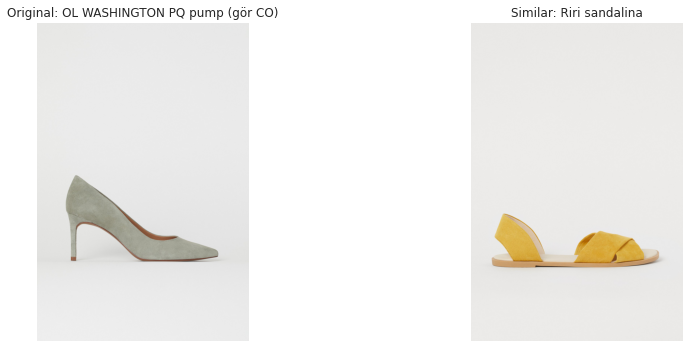

../Dataset/images/074/0740050006.jpg
../Dataset/images/069/0692979001.jpg


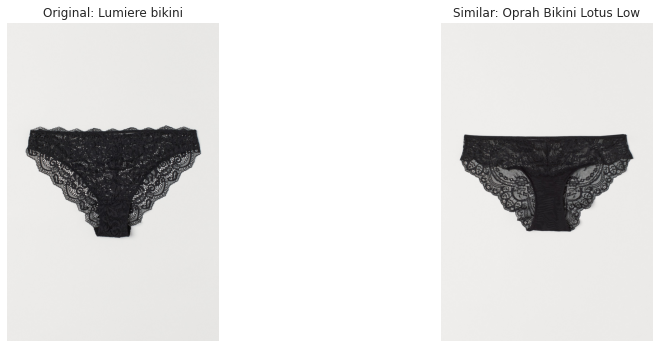

../Dataset/images/056/0562245059.jpg
../Dataset/images/055/0552346001.jpg


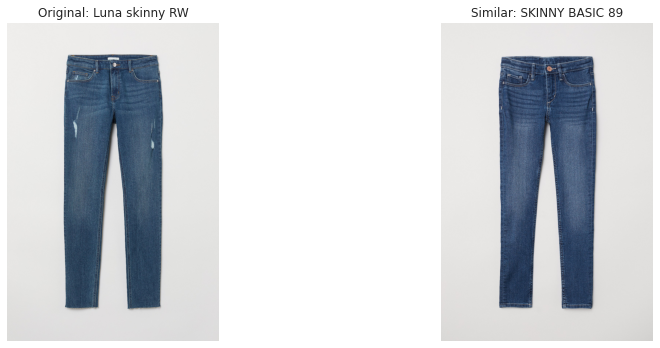

../Dataset/images/075/0751935001.jpg
../Dataset/images/089/0898676001.jpg


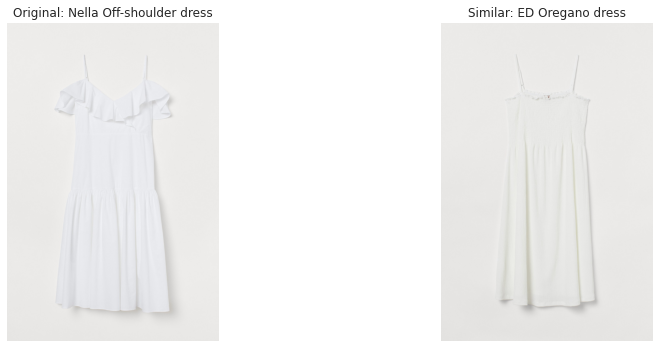

../Dataset/images/075/0751567006.jpg
../Dataset/images/083/0835563006.jpg


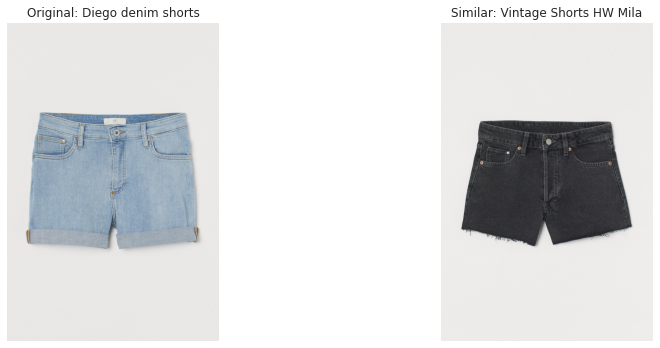

../Dataset/images/076/0761335002.jpg
../Dataset/images/057/0579541027.jpg


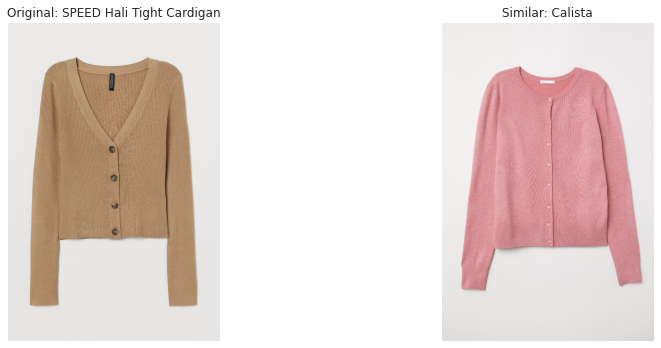

../Dataset/images/065/0658298014.jpg
../Dataset/images/067/0674606035.jpg


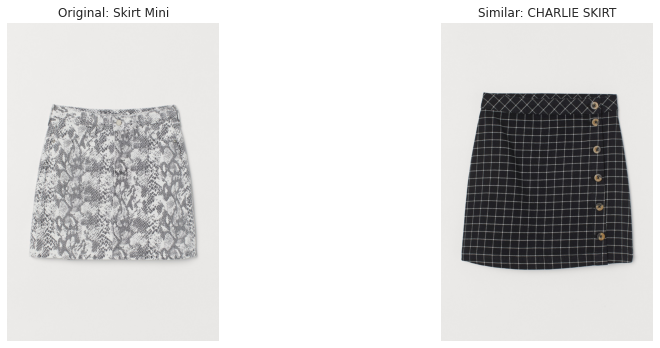

../Dataset/images/087/0876276001.jpg
../Dataset/images/070/0708085001.jpg


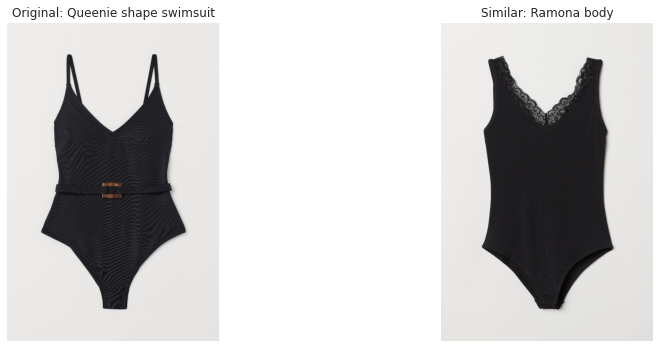

../Dataset/images/069/0698283002.jpg
../Dataset/images/068/0689009001.jpg


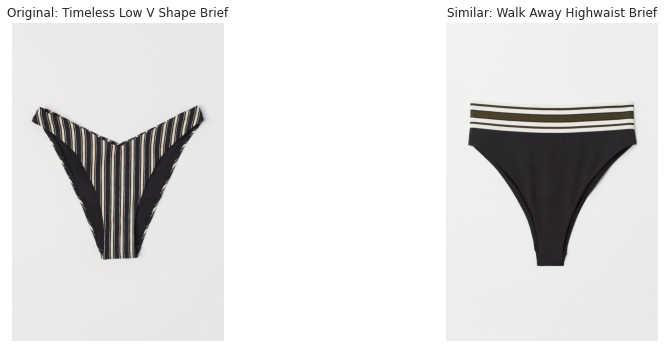

../Dataset/images/050/0509210020.jpg
../Dataset/images/054/0543310004.jpg


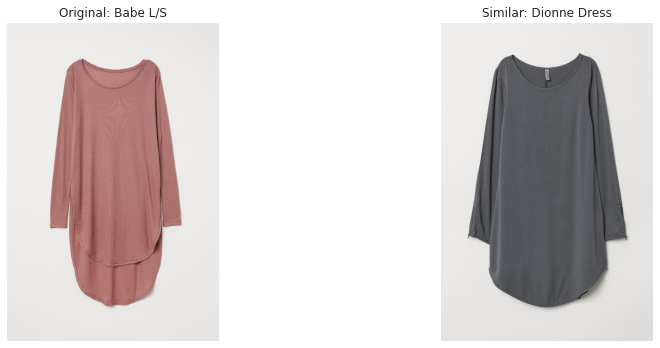

../Dataset/images/085/0856667004.jpg
../Dataset/images/074/0743979002.jpg


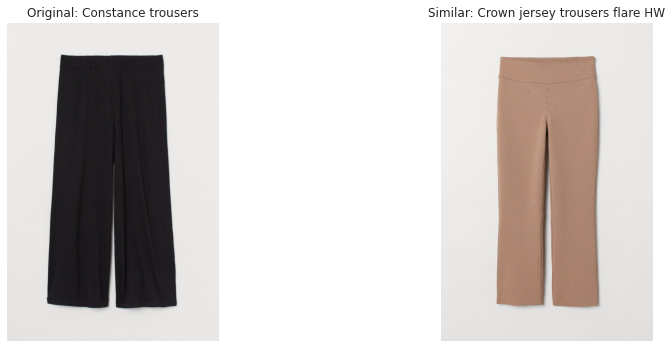

../Dataset/images/077/0777892001.jpg
../Dataset/images/062/0625345002.jpg


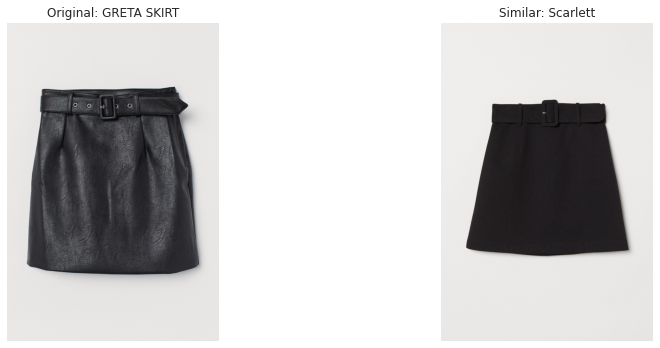

../Dataset/images/075/0751273003.jpg
../Dataset/images/065/0655784003.jpg


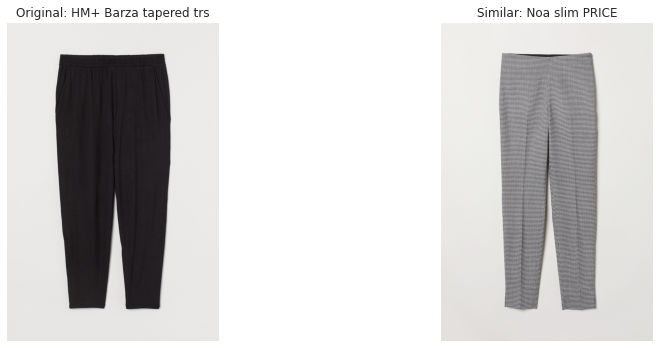

../Dataset/images/086/0866520001.jpg
../Dataset/images/068/0687034007.jpg


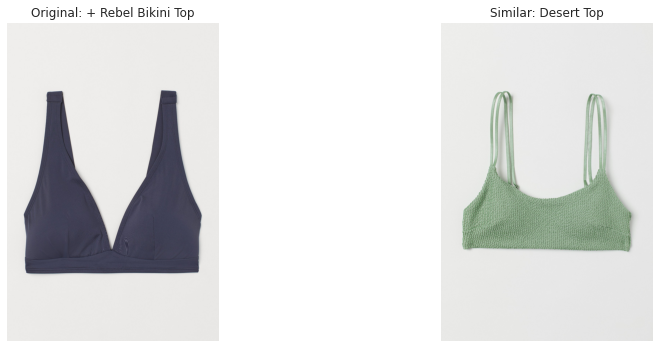

../Dataset/images/072/0727706002.jpg
../Dataset/images/075/0755458008.jpg


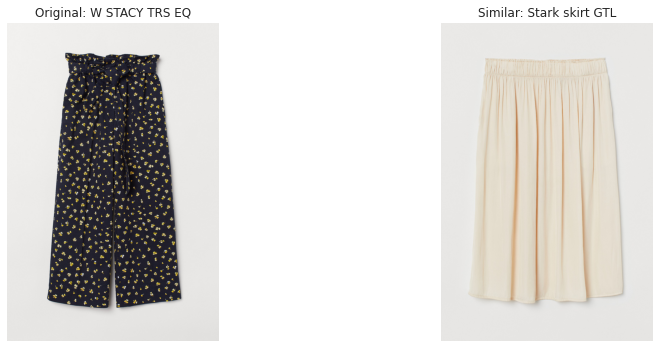

../Dataset/images/076/0764536002.jpg
../Dataset/images/081/0810156001.jpg


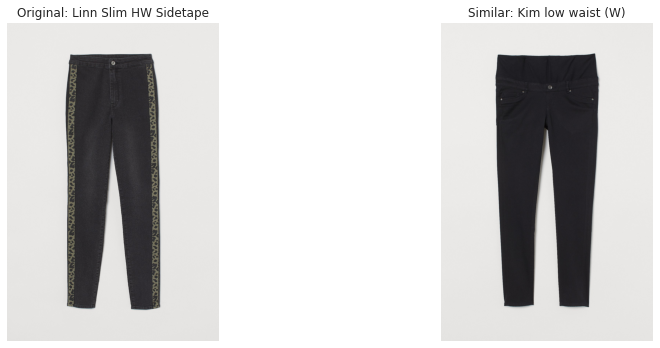

../Dataset/images/084/0844915003.jpg
../Dataset/images/077/0771964002.jpg


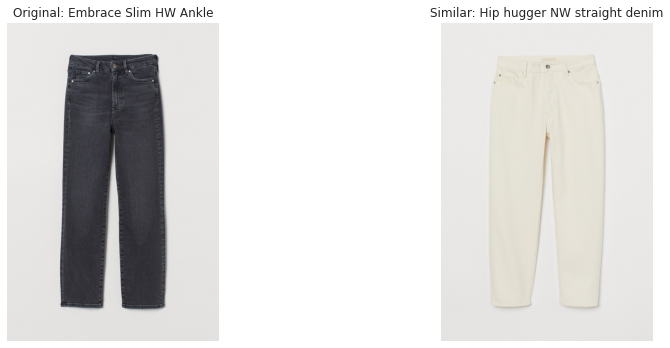

../Dataset/images/087/0871005001.jpg
../Dataset/images/074/0740234001.jpg


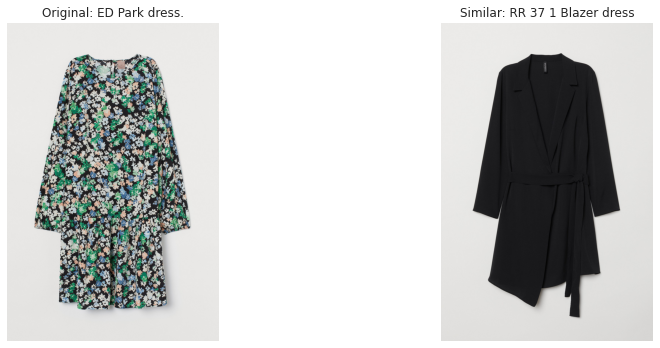

../Dataset/images/063/0636323004.jpg
../Dataset/images/055/0558512008.jpg


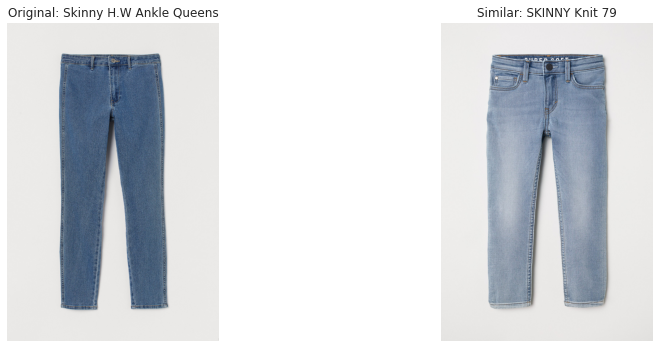

../Dataset/images/070/0708394005.jpg
../Dataset/images/057/0576897001.jpg


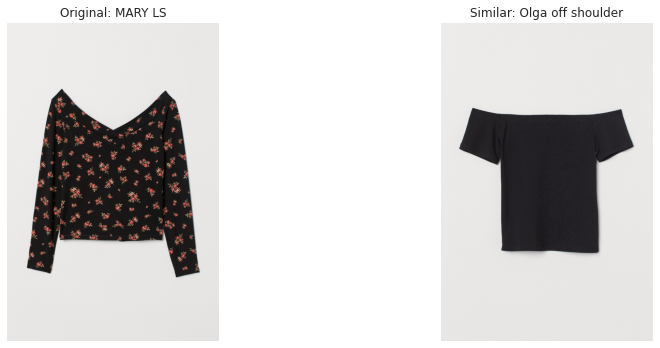

../Dataset/images/069/0699253001.jpg
../Dataset/images/073/0736530014.jpg


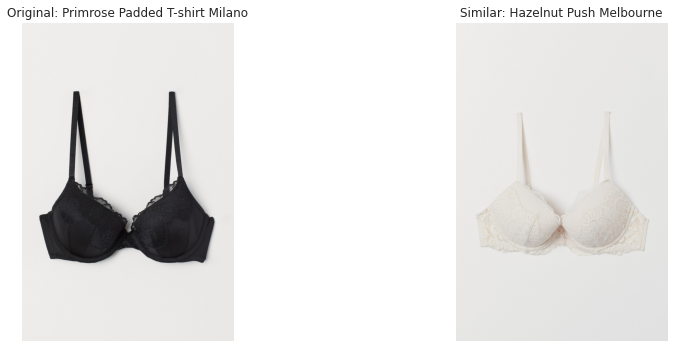

../Dataset/images/085/0852228002.jpg
../Dataset/images/081/0817416004.jpg


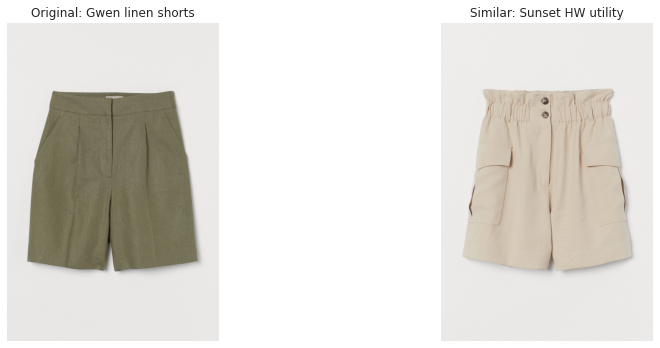

../Dataset/images/082/0826218003.jpg
../Dataset/images/076/0768147001.jpg


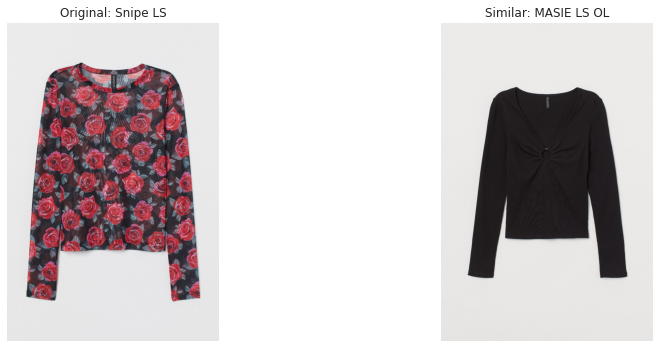

../Dataset/images/083/0836997006.jpg
../Dataset/images/057/0570002073.jpg


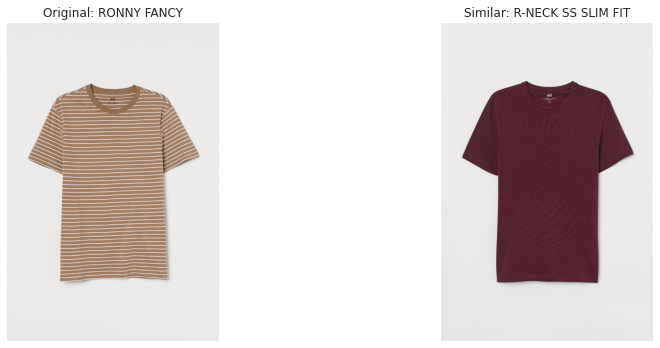

../Dataset/images/075/0754926002.jpg
../Dataset/images/055/0557247001.jpg


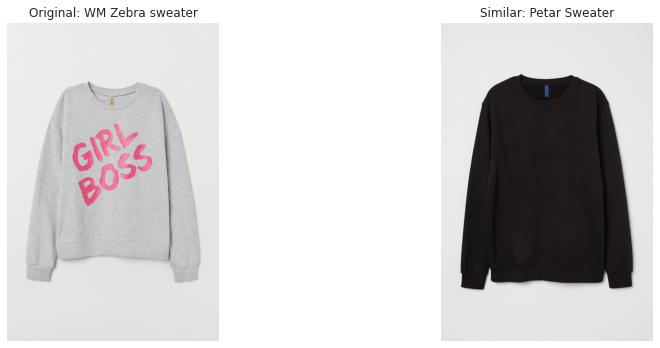

../Dataset/images/057/0576661009.jpg
../Dataset/images/074/0749656002.jpg


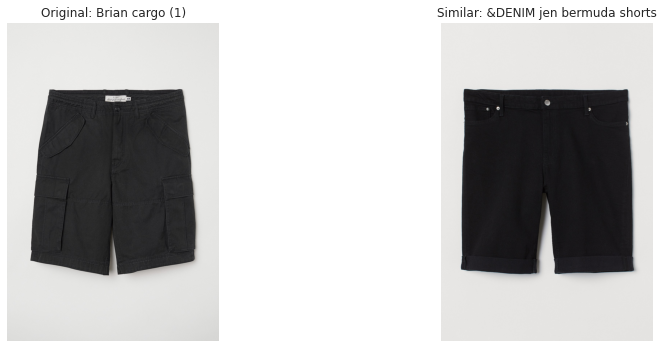

../Dataset/images/030/0305304020.jpg
../Dataset/images/087/0878816006.jpg


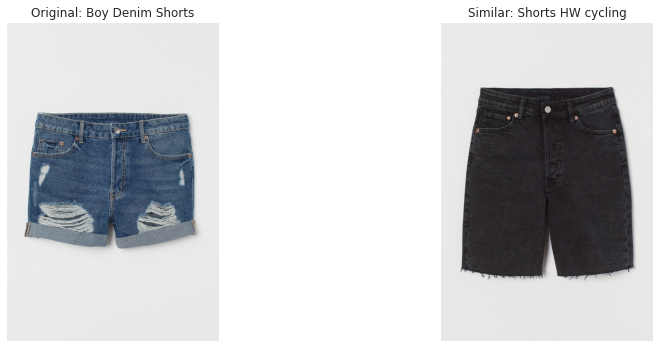

../Dataset/images/068/0685347011.jpg
../Dataset/images/069/0693456001.jpg


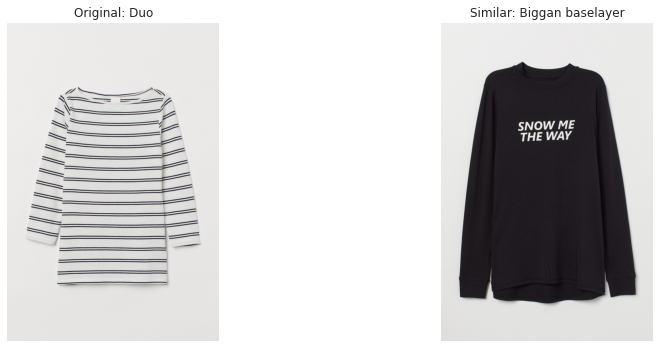

../Dataset/images/077/0774873001.jpg
../Dataset/images/075/0751530002.jpg


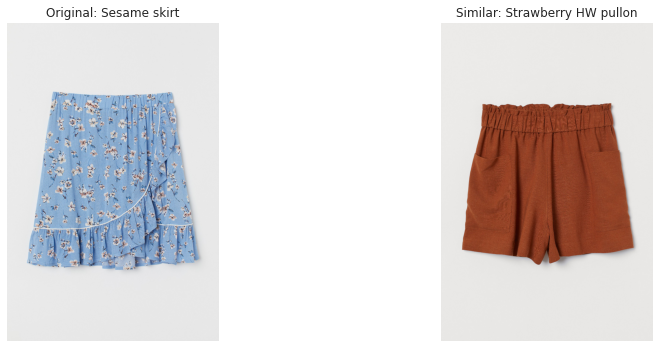

../Dataset/images/077/0774279002.jpg
../Dataset/images/052/0522398011.jpg


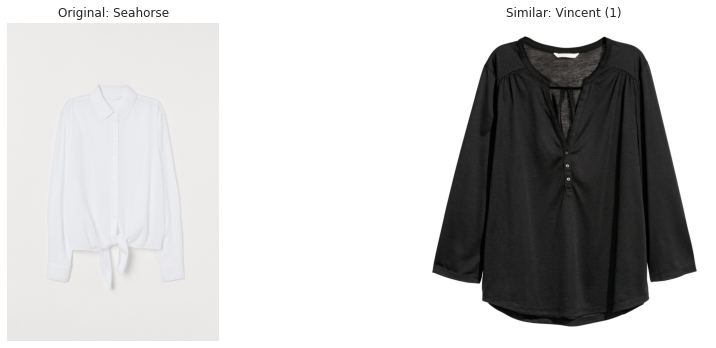

../Dataset/images/063/0630116001.jpg
../Dataset/images/076/0766346004.jpg


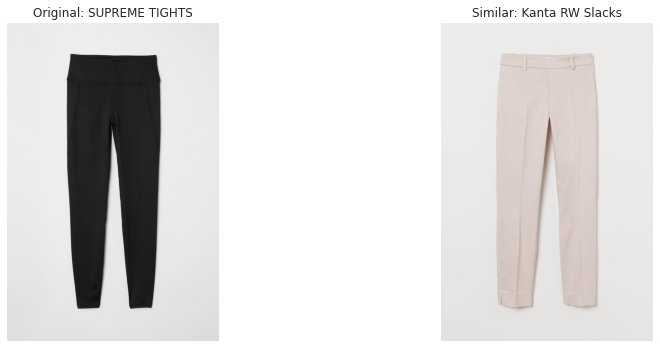

../Dataset/images/046/0469039034.jpg
../Dataset/images/070/0704593003.jpg


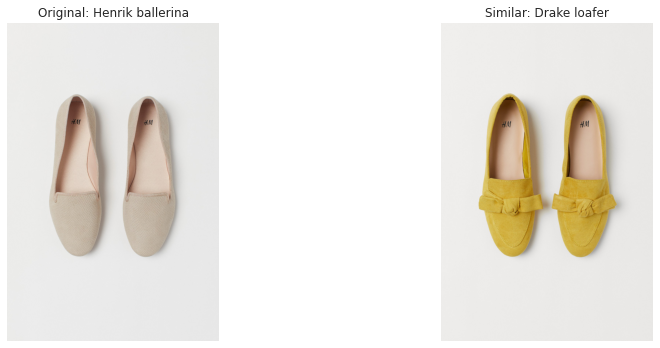

../Dataset/images/088/0884319003.jpg
../Dataset/images/072/0721932003.jpg


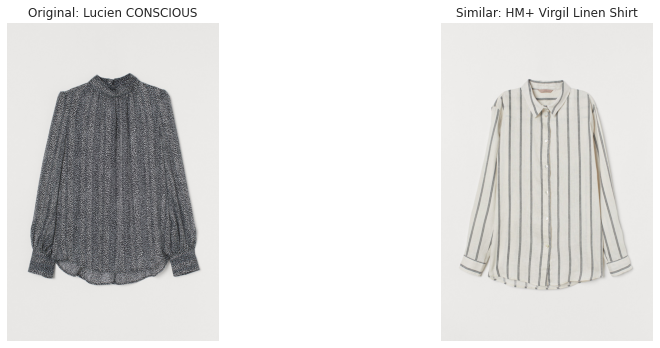

../Dataset/images/076/0760084013.jpg
../Dataset/images/021/0219075023.jpg


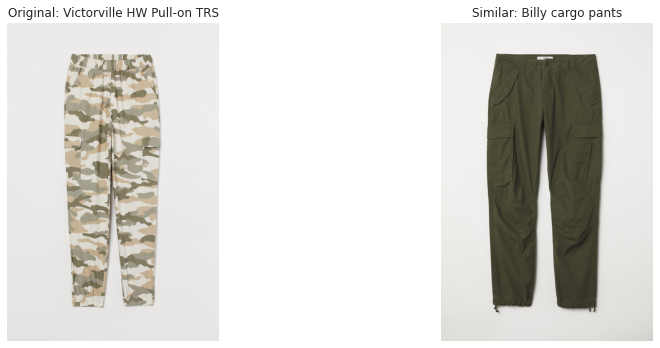

../Dataset/images/085/0851992001.jpg
../Dataset/images/066/0661166006.jpg


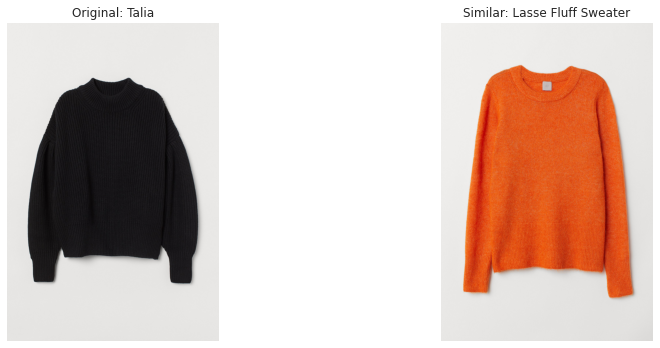

../Dataset/images/076/0766346004.jpg
../Dataset/images/058/0580840001.jpg


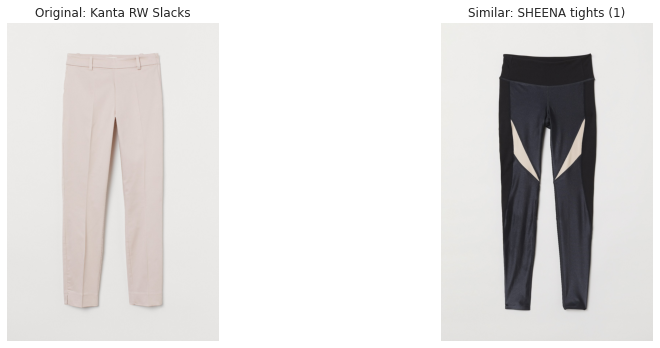

../Dataset/images/074/0745334002.jpg
../Dataset/images/078/0784467007.jpg


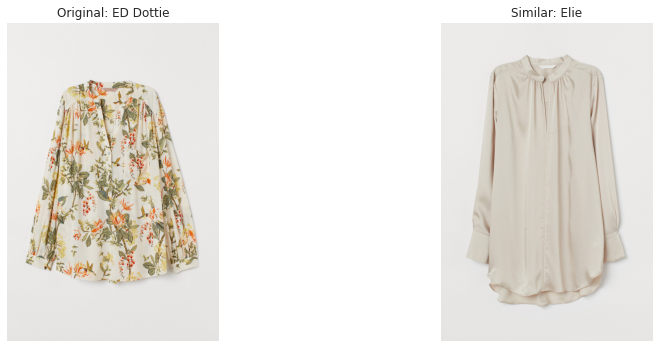

../Dataset/images/051/0516000099.jpg
../Dataset/images/071/0715255008.jpg


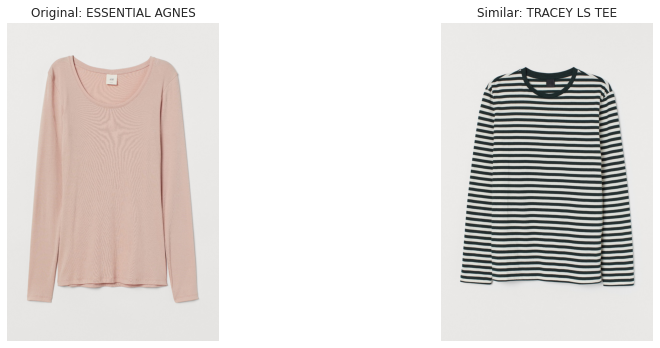

../Dataset/images/085/0855235001.jpg
../Dataset/images/072/0722750003.jpg


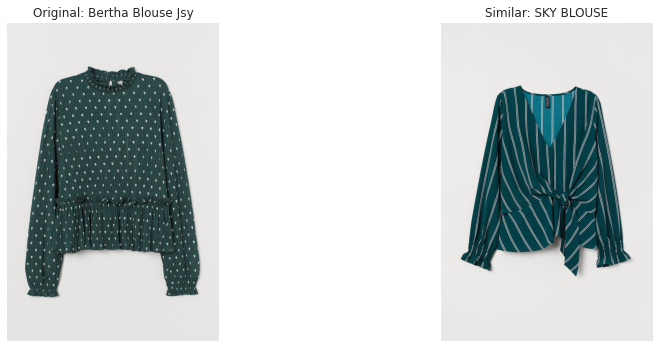

../Dataset/images/082/0829618006.jpg
../Dataset/images/065/0654046004.jpg


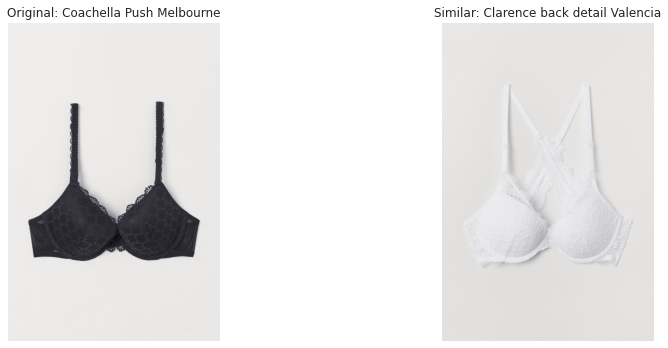

../Dataset/images/068/0689389033.jpg
../Dataset/images/068/0688873011.jpg


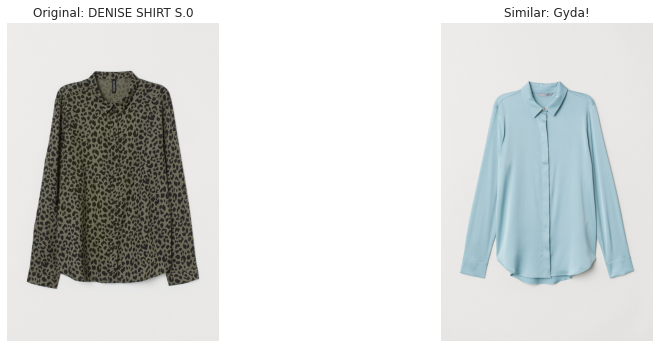

../Dataset/images/075/0755361004.jpg
../Dataset/images/075/0755362003.jpg


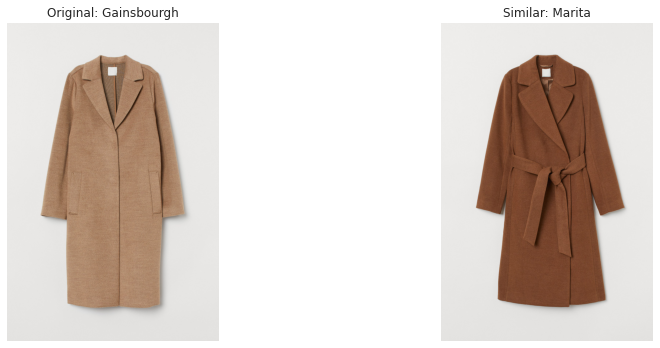

../Dataset/images/064/0640476002.jpg
../Dataset/images/082/0829618006.jpg


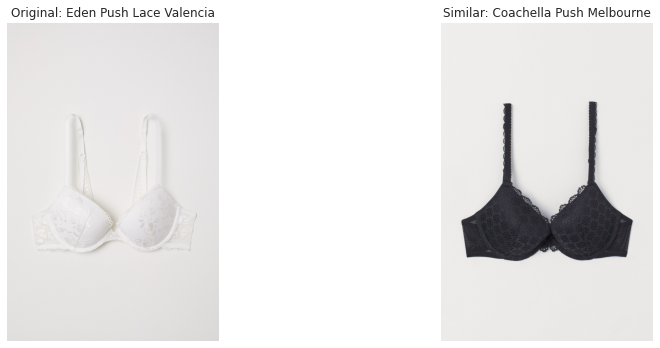

../Dataset/images/067/0672625005.jpg
../Dataset/images/078/0781225002.jpg


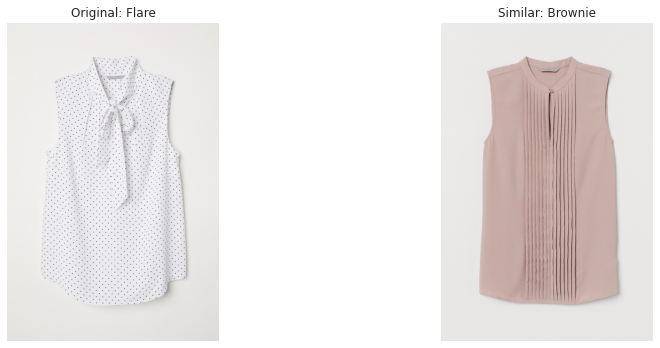

../Dataset/images/074/0741040001.jpg
../Dataset/images/062/0621759003.jpg


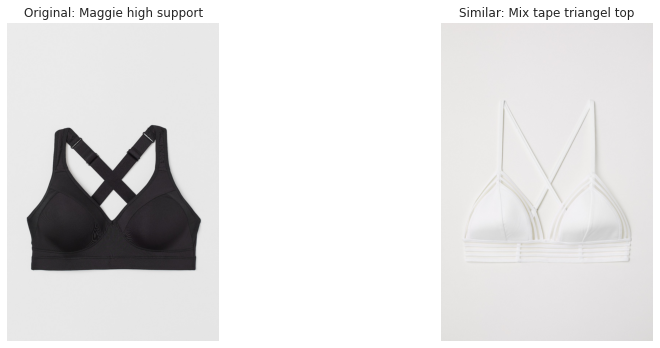

../Dataset/images/078/0788107006.jpg
../Dataset/images/077/0770030003.jpg


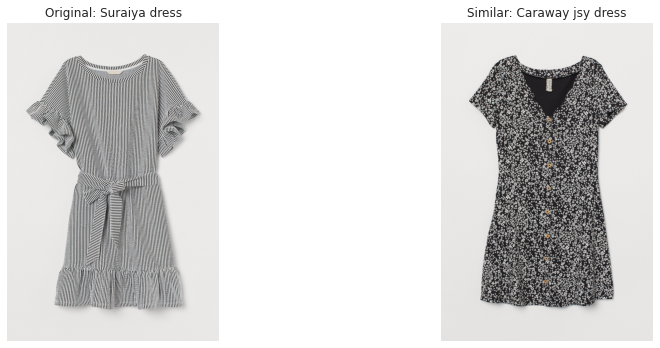

../Dataset/images/062/0626263003.jpg
../Dataset/images/055/0554450042.jpg


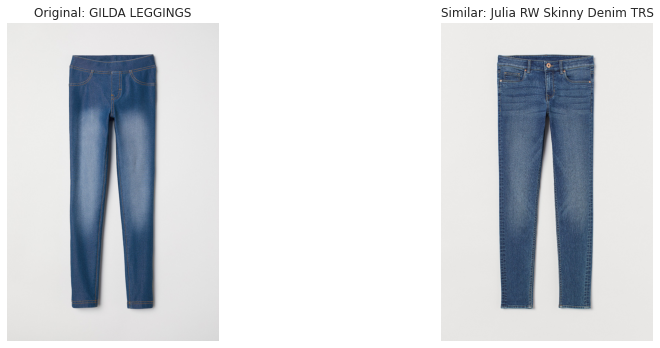

../Dataset/images/077/0778798002.jpg
../Dataset/images/051/0516903017.jpg


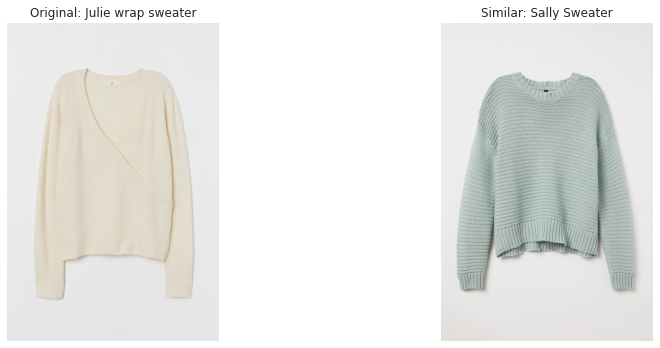

../Dataset/images/069/0698896001.jpg
../Dataset/images/074/0743604001.jpg


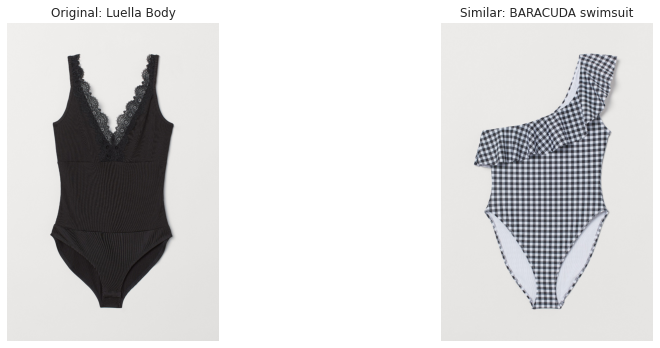

../Dataset/images/088/0886538002.jpg
../Dataset/images/088/0888026001.jpg


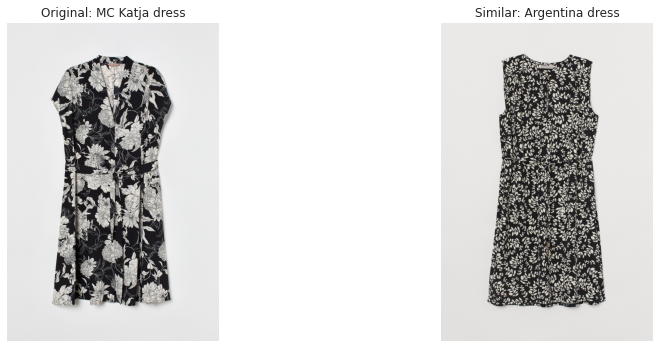

In [96]:
worst_negative_matches = [ 173,  199,  490,  591,  603,  905,  958,  971,  987, 1055, 1551,
            1742, 2069, 2185, 2281, 2294, 2413, 2444, 2955, 2994, 3076, 3086,
            3366, 3521, 3562, 3814, 4167, 4239, 4247, 4549, 4672, 4980, 5122,
            5233, 5242, 5320, 5651, 6005, 6149, 6182, 6183, 6228, 6284, 6909,
            6914, 7230, 7550, 7889, 8415, 8461]
tup = [negative_test_pairs[match] for match in worst_negative_matches]
for item_index, similar_item in tup:

    # Sample: Choose an item index and retrieve its positive pairs
    item_index = item_index # You can choose any item index here
    similar_items = [similar_item]#indices[item_index][:5]  # Get top 5 similar items (indices)

    # Prepare to display the original item and its similar items
    fig, axes = plt.subplots(1, len(similar_items) + 1, figsize=(15, 5))

    # Show the original item
    original_item = dataset.iloc[item_index]
    print(f"../{original_item['image_path']}")
    img = mpimg.imread(f"../{original_item['image_path']}")
    axes[0].imshow(img)
    axes[0].axis('off')
    axes[0].set_title(f"Original: {original_item['prod_name']}")

    # Show the similar items
    for idx, similar_index in enumerate(similar_items):
        similar_item = dataset.iloc[similar_index]
        print(f"../{similar_item['image_path']}")
        img = mpimg.imread(f"../{similar_item['image_path']}")

        axes[idx + 1].imshow(img)
        axes[idx + 1].axis('off')
        axes[idx + 1].set_title(f"Similar: {similar_item['prod_name']}")

    plt.tight_layout()
    plt.show()
